# Team 6 Project: MINJUSTICIA

Here, we read the csv file with all the data provided by the Ministry of Justice. This file was initially preprocessed, removing headers and additional information different to the entries themselves.

The data contains all recidivism entries since 2010 up to date.

Also, we import all the packages needed for the analysis and model creation.

In [3]:
# Save/load models
import joblib
import pickle

# Data Analysis
import pandas as pd
import numpy as np
from datetime import datetime, timedelta

# Survival model fitting and ensuring last version
import pkg_resources
pkg_resources.require("lifelines==0.25")
from lifelines import KaplanMeierFitter, CoxPHFitter

# Graphics
import seaborn as sns
from scipy import stats
pd.options.display.max_columns = 50
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode(connected=True) 

import plotly
import plotly.express as px
import plotly.graph_objects as go

%matplotlib inline

url="https://raw.githubusercontent.com/danncalle/ds4a-team6-1/master/retomintic/Data_UpdateJune13/reincidencia11junio2020_clean.csv"
df_mj = pd.read_csv(url, sep=",",encoding="utf-8")

# Processing

## 1. Data cleaning: 

In this step we calculate:
- Days between consecutives captures for each individual.
- Days between consecutives entrances to prison dates for each individual.
- Days between consecutives release dates of prison for each individual.

Then, we calculate:
- Length of sentence for each individual's crime.
- Days between capture and entrance to prison dates.
- Days out of prison before next reoffense or up-to-date if the individual did not reoffend again.

Finally,
- The last reoffense of each individual is mark as censored because that person is either in jail or free.

In [5]:
#Date variables are parsed to datetime
df_mj["FECHA_CAPTURA"] = pd.to_datetime(df_mj["FECHA_CAPTURA"])
df_mj["FECHA_INGRESO"] = pd.to_datetime(df_mj["FECHA_INGRESO"])
df_mj["FECHA_SALIDA"] = pd.to_datetime(df_mj["FECHA_SALIDA"])
#Month and year variables are defined
df_mj["MES_INGRESO_INT"]=df_mj["FECHA_INGRESO"].dt.strftime('%m')
df_mj["ANO_INGRESO_INT"]=df_mj["FECHA_INGRESO"].dt.strftime('%y')
#Calculations on how much time have the criminal being outside since its last stay in jail
for column in ['FECHA_INGRESO', 'FECHA_SALIDA', 'FECHA_CAPTURA']:
    df_mj = df_mj.sort_values(['INTERNOEN', column], ascending = False)
    
    df_mj['DIAS' + column[5:]] = -1*(df_mj[column].diff()/timedelta(days = 1))

    df_mj.loc[(df_mj.INTERNOEN != df_mj.INTERNOEN.shift(1)) | (df_mj['DIAS' + column[5:]] == 0), 
              ['DIAS' + column[5:]]] = (datetime.today() - df_mj[column])/timedelta(days = 1)
    
#It seems that sometimes entering and gettint out is switched, that's why we computed in absolute values
df_mj['DIAS_CONDENA'] = abs(df_mj['FECHA_SALIDA'] - df_mj['FECHA_INGRESO'])/timedelta(days = 1)
df_mj['DIAS_JUDICIALIZACION'] = df_mj['FECHA_INGRESO'] - df_mj['FECHA_CAPTURA']
df_mj['DIAS_LIBRE'] = df_mj['DIAS_INGRESO'] - df_mj['DIAS_CONDENA']
#The individual finishes its sentence but she's incarcelated inmediately for another crime
df_mj.loc[df_mj.DIAS_CAPTURA < 0, 'DIAS_CAPTURA'] = 0
df_mj.loc[df_mj.DIAS_INGRESO < 0, 'DIAS_INGRESO'] = 0
df_mj.loc[df_mj.DIAS_LIBRE < 0, 'DIAS_LIBRE'] = 0
#The individual is still on jail
df_mj.loc[df_mj['DIAS_LIBRE'].isnull(), 'DIAS_LIBRE'] = 0

#Find the last date the criminal went out the jail, so that these observations are marked as censored
last_df = df_mj[['INTERNOEN', 'FECHA_INGRESO']].groupby('INTERNOEN').apply(lambda x: x.sort_values('FECHA_INGRESO', ascending = False).head(1)).reset_index(drop = True)
#Censored
last_df['CENSURADO_LIBRES'] = 0
df_mj = df_mj.merge(last_df, on = ['INTERNOEN', 'FECHA_INGRESO'], how = 'left')
#Event
df_mj.loc[df_mj['CENSURADO_LIBRES'].isnull(), 'CENSURADO_LIBRES'] = 1
#All criminals that haven't got out of jail yet have zero days out and they are not censored.
df_mj.loc[df_mj['FECHA_SALIDA'].isnull(), 'CENSURADO_LIBRES'] = 1
#Turned censored variables to integers instead of float
df_mj['CENSURADO_LIBRES'] = df_mj['CENSURADO_LIBRES'].astype('int64')

#We create a variable to count the amount of times the individual re-entered in jail
df_mj = df_mj.merge(df_mj.drop_duplicates(['INTERNOEN', 'FECHA_INGRESO']).groupby(['INTERNOEN']).size().reset_index(name = 'NUMERO_REINCIDENCIAS'), on = 'INTERNOEN', how = 'left')

#We dropped SITUACION_JURIDICA and REINCIDENTE as both columns are constants
df_mj = df_mj.drop(columns = ['SITUACION_JURIDICA', 'REINCIDENTE'])

## Merging subnational human development index colombia (SHDI) data to Dataframe

Here, we read the file describing all the entries of the SHDI file that will be read in the next step. In this file, we can find a description of each field and the data type.

In [6]:
url="https://raw.githubusercontent.com/danncalle/ds4a-team6-1/master/retomintic/Data_UpdateJune13/shdi-4.0.csv"
df_shdi = pd.read_csv(url, sep=",",encoding="utf-8")

In [7]:
df_shdi

,Variable,Category,Dtype,Decimals,RankOrder,Label,Shortdescr,Longdescr
0,iso_code,System,Str,NaN,NaN,NaN,ISO country code 3 digit,ISO country code 3 digit
1,country,System,Str,NaN,NaN,NaN,Country name,Country name
2,year,System,Int,0.0,NaN,NaN,Year of data collection,Year of data collection
3,GDLCODE,System,Str,NaN,NaN,NaN,Region code Global Data Lab,"Iso-code, level (t=total), regional division (..."
4,level,System,Str,NaN,NaN,NaN,Aggregation level,National or sub-national
5,region,System,Str,NaN,NaN,NaN,Sub-national region name,Name of sub-national region
6,continent,System,Flt,NaN,NaN,NaN,Continent,"Categories: Africa, America, Asia/Pacific, Europe"
7,shdi,Indices,Pos,3.0,A,Sub-national HDI,Sub-national HDI,NaN
8,healthindex,Indices,Pos,3.0,A,Health index,Health index,NaN
9,incindex,Indices,Pos,3.0,A,Income index,Income index,NaN


**Reading the SHDI file**<br>
Here, we read the csv file with all the data from the SHDI file: Subnational Human Development Index. 

This data contains the historical information of the SHDI index since before 2010 until 2018.

In [8]:
url="https://raw.githubusercontent.com/danncalle/ds4a-team6-1/master/retomintic/Data_UpdateJune13/SHDI%20Colombia%204.0.csv"
df_shdi_col = pd.read_csv(url, sep=";",encoding="utf-8")

In [728]:
df_shdi_col.head()

,iso_code,country,year,GDLCODE,level,region,continent,shdi,healthindex,incindex,edindex,lifexp,gnic,esch,msch,pop
0,COL,Colombia,90,COLr101,Subnat,antioquia,America,"0,603","0,785","0,675","0,413","71,02","8,719078","8,63","5,2","4,092471"
1,COL,Colombia,90,COLr102,Subnat,atlantico,America,"0,631","0,785","0,66","0,484","71,02","7,910401","9,89","6,28","2,315525"
2,COL,Colombia,90,COLr103,Subnat,bogota,America,"0,673","0,778","0,709","0,552","70,59","10,950703","10,54","7,78","4,715131"
3,COL,Colombia,90,COLr104,Subnat,bolivar,America,"0,587","0,724","0,623","0,449","67,06","6,169956","9,39","5,65","1,122177"
4,COL,Colombia,90,COLr105,Subnat,boyaca,America,"0,567","0,804","0,603","0,375","72,24","5,404022","8,7",4,"1,556152"


Next, we need to match the information from the recidivism dataframe with the SHDI dataframe. The connection must be done using the year column and the region column but we need to match the formats:

Year in the SHDI file is: 1990, 1991, 1992, ..., 2010, 2011, ..., 2018. We only need 10-18.
Year in the Recidivism file is: DD/MM/YY for each crime of each individual. We need only the year and match the format.

The region in the SHDI file has some orthographic mistakes and they are corrected in the next step.
The region in the Recidivism file has several differences in each entry and is initially filled as: locality-city-department.

First, we will take the unique departments in the SHDI file and correct them.

In [731]:
prueba = list(df_mj.DEPARTAMENTO)
prueba = [str(dept).lower() for dept in prueba]

dept_shdi = [str(dept).lower() for dept in list(df_shdi_col.region.unique())]

In [729]:
import re
colombian_depts = list()
for elem in dept_shdi:
    new_elem = re.findall(r'([a-z].*)\(',elem)
    if len(new_elem)==0: 
        new_elem = re.findall(r'([a-z].*)',elem)
    colombian_depts = colombian_depts + new_elem

colombian_depts = [dept.strip() for dept in colombian_depts]
    
colombian_depts[2] = 'bogota'
colombian_depts[31] = 'vaupes'
colombian_depts[29] = 'guainia'
colombian_depts[23] = 'valle del cauca'
colombian_depts = colombian_depts[:-1]
len(colombian_depts)

# There are 33 departments because Bogota is separated.

33

Now that we have the list of the departments in a homogeneus format. We will correct the region column in the SHDI file.

In [13]:
s = df_shdi_col.region
# print(colombian_depts)
for index, value in s.iteritems():
    value = str(value).lower().strip()
    for dept in colombian_depts:
        if "guain" in value:
            df_shdi_col.loc[index,"region"] = "guainia"
            break
        elif "valle del cauca" in value:
            df_shdi_col.loc[index,"region"] = "valle del cauca"
            break
        elif "vaup" in value:
            df_shdi_col.loc[index,"region"] = "vaupes"
            break
        elif "cali" in value:
            df_shdi_col.loc[index,"region"] = "valle del cauca"            
        elif dept in value:
            df_shdi_col.loc[index,"region"] = dept
            break
        else:
            continue
#             print(value, dept)
# df_shdi_col.region.unique()

Now that the Region column in the SHDI file is OK. We proceed to match these names with the ones in the "prueba" list created before, which contains the values of the departments in the Recidivism file. There are several exceptions and all are treated in the following piece of code.

In [14]:
print(len(prueba))
counter = 0
foreign = list()
for elem in prueba:
    flag = 0
    orig = elem
    elem = elem.strip()
    elem2 = ''.join(elem.split('-')[1:])
    if len(elem2)>0: elem = elem2
    if elem in colombian_depts: 
        prueba[prueba.index(orig)] = elem
    elif "bogota" in elem:
        prueba[prueba.index(orig)] = 'bogota'
    elif elem == "la guajira":
        prueba[prueba.index(orig)] = 'guajira'
    elif elem == "nariño":
        prueba[prueba.index(orig)] = 'narino'
    elif "san andres" in elem:
        prueba[prueba.index(orig)] = 'san andres'
    elif "pereira" in elem:
        prueba[prueba.index(orig)] = 'risaralda'
    elif "magdalena" in elem:
        prueba[prueba.index(orig)] = 'magdalena'
    elif "tolima" in elem:
        prueba[prueba.index(orig)] = 'tolima'
    elif "choco" in elem:
        prueba[prueba.index(orig)] = 'choco'
    elif "caldas" in elem:
        prueba[prueba.index(orig)] = 'caldas'
    elif "armenia" in elem:
        prueba[prueba.index(orig)] = 'quindio'
    else: foreign.append(elem)
# set(prueba)
# set(foreign)

142899


Now, let us assign the values of the corrected "prueba" list to the region column in the recidivism file, which is called "DEPARTAMENTO".

In [16]:
df_mj_reg = df_mj.copy()
df_mj_reg["DEPARTAMENTO"] = pd.Series(prueba)

There are still some mismatches, since some regions in the "DEPARTAMENTO" column are written as countries for foreign reoffenders or even "republica de colombia". For the last case, we checked the column "DEPTO_ESTABLECIMIENTO" which has information on the region where the reoffender is fulfulling his/her sentence. In this column, we need to extract the department, which is not straightforward. Therefore, we notice that the city field of these strange entries has in most cases the region value. We fix all exceptions one by one.

In [18]:
s = df_mj_reg[df_mj_reg["DEPARTAMENTO"]=="republica de colombia"].CIUDAD
print(s)

for index, value in s.iteritems():
    if str(value).lower().strip() in colombian_depts:
        df_mj_reg.loc[index, 'DEPARTAMENTO'] = str(value).lower().strip()
    elif value == "REPUBLICA DE COLOMBIA":
        temp = df_mj_reg.loc[index, "DEPTO_ESTABLECIMIENTO"]
        if str(temp).lower().strip() in colombian_depts:
            df_mj_reg.loc[index, 'DEPARTAMENTO'] = str(temp).lower().strip()
        else:
            temp = df_mj_reg.loc[index, "ESTABLECIMIENTO"]
            if "IBAGUE" in temp:
                df_mj_reg.loc[index, 'DEPARTAMENTO'] = "tolima"
            else:
                print(df_mj_reg.loc[index, ["ESTABLECIMIENTO","DEPTO_ESTABLECIMIENTO","MPIO_ESTABLECIMIENTO"]])
    
    else:
        if value == "NARIÑO":
            df_mj_reg.loc[index, 'DEPARTAMENTO'] = "narino"
        else:
            print(index, value)


1978            ANTIOQUIA
1979            ANTIOQUIA
1980            ANTIOQUIA
2583      VALLE DEL CAUCA
2584      VALLE DEL CAUCA
               ...       
140726             CALDAS
140727             CALDAS
140728             CALDAS
140729             CALDAS
142773             NARIÑO
Name: CIUDAD, Length: 127, dtype: object


We do a quick check of the amount of foreigners remaining and can see that there are just a few.

In [19]:
foreign = list()
for dept in list(df_mj_reg.DEPARTAMENTO.unique()):
    if dept in colombian_depts: continue
    else:
        foreign.append(dept)

**Now, we fix the year of the SHDI file by taking only the last two digits.**

**Similarly, we take the year of the Recidivism dataframe and convert it to Integer**

In [20]:
df_shdi_col.head()
df_shdi_col.year = df_shdi_col.year.apply(lambda x: int(str(x)[2:]))

In [21]:
df_mj.ANO_INGRESO_INT = df_mj.ANO_INGRESO_INT.astype('int64')
df_mj_reg.ANO_INGRESO_INT = df_mj_reg.ANO_INGRESO_INT.astype('int64')

**Finally, we merge both dataframes.**

In [24]:
df_mj_shdi = pd.merge(df_mj_reg,df_shdi_col, left_on=["ANO_INGRESO_INT","DEPARTAMENTO"], right_on=["year","region"]).drop(columns=["continent","region","year","level","GDLCODE","iso_code"])

## Data analysis

Now that we have a dataframe with all the data, the first check is correlations between variables. We will begin by calculating and printing the correlation matrix. Then, we will see it graphically to be sure we are getting all the details. Then, we do a pairplot to check for deepen the understanding of how each pair of variables correlate.

We must correct all the index and convert them to float, since they come as strings from the original csv.

In [25]:
df_corr = df_mj_shdi[~df_mj_shdi.DIAS_CONDENA.isna()]
df_corr.corr()

,ANO_NACIMIENTO,EDAD,CODIGO_ESTABLECIMIENTO,ANO_INGRESO_INT,DIAS_INGRESO,DIAS_SALIDA,DIAS_CAPTURA,DIAS_CONDENA,DIAS_LIBRE,CENSURADO_LIBRES,NUMERO_REINCIDENCIAS
ANO_NACIMIENTO,1.000000,-0.998755,-0.038589,0.162878,-0.196705,-0.159627,-0.209702,-0.043746,-0.180847,0.109093,0.118168
EDAD,-0.998755,1.000000,0.038358,-0.162788,0.196610,0.159708,0.209668,0.043525,0.180873,-0.109030,-0.118157
CODIGO_ESTABLECIMIENTO,-0.038589,0.038358,1.000000,-0.014039,0.033995,0.013667,0.063885,0.024167,0.021348,-0.012592,-0.030852
ANO_INGRESO_INT,0.162878,-0.162788,-0.014039,1.000000,-0.700912,-0.717589,-0.443268,-0.218289,-0.608712,-0.301557,0.006039
DIAS_INGRESO,-0.196705,0.196610,0.033995,-0.700912,1.000000,0.726628,0.683805,0.363058,0.835558,-0.233097,-0.375824
DIAS_SALIDA,-0.159627,0.159708,0.013667,-0.717589,0.726628,1.000000,0.572821,-0.270392,0.923480,0.090061,-0.148851
DIAS_CAPTURA,-0.209702,0.209668,0.063885,-0.443268,0.683805,0.572821,1.000000,0.110727,0.652959,-0.253160,-0.386880
DIAS_CONDENA,-0.043746,0.043525,0.024167,-0.218289,0.363058,-0.270392,0.110727,1.000000,-0.207874,-0.165451,-0.188082
DIAS_LIBRE,-0.180847,0.180873,0.021348,-0.608712,0.835558,0.923480,0.652959,-0.207874,1.000000,-0.145872,-0.282853
CENSURADO_LIBRES,0.109093,-0.109030,-0.012592,-0.301557,-0.233097,0.090061,-0.253160,-0.165451,-0.145872,1.000000,0.660179


In [26]:
index = ["shdi","healthindex", 'incindex',
       'edindex', 'gnic', 'esch', 'msch','pop']

for col in index:
    df_corr[col] = df_corr[col].apply(lambda x: np.float(x.replace(",",".")))

<ipython-input-26-f917c7a99143>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Text(0.5, 1, 'Correlations between numerical variables')

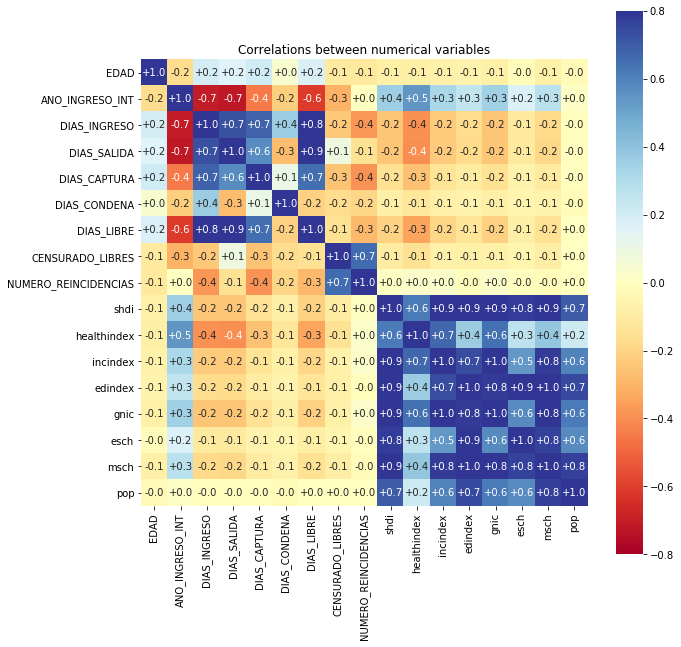

In [41]:
var = ["EDAD","ANO_INGRESO_INT","DIAS_INGRESO","DIAS_SALIDA","DIAS_CAPTURA","DIAS_CONDENA"
        ,"DIAS_LIBRE","CENSURADO_LIBRES","NUMERO_REINCIDENCIAS", "shdi","healthindex", 'incindex',
       'edindex', 'gnic', 'esch', 'msch','pop',"GENERO"]
df_corr.corr()

df_corr = df_corr[var]
# print(df_corr.head(1))
#-----------------------------------------
plt.figure(figsize=(10,10))
sns.heatmap(df_corr.corr(), cmap="RdYlBu", 
    annot=True, square=True,
    vmin=-0.8, vmax=0.8, fmt="+.1f")
plt.title("Correlations between numerical variables")

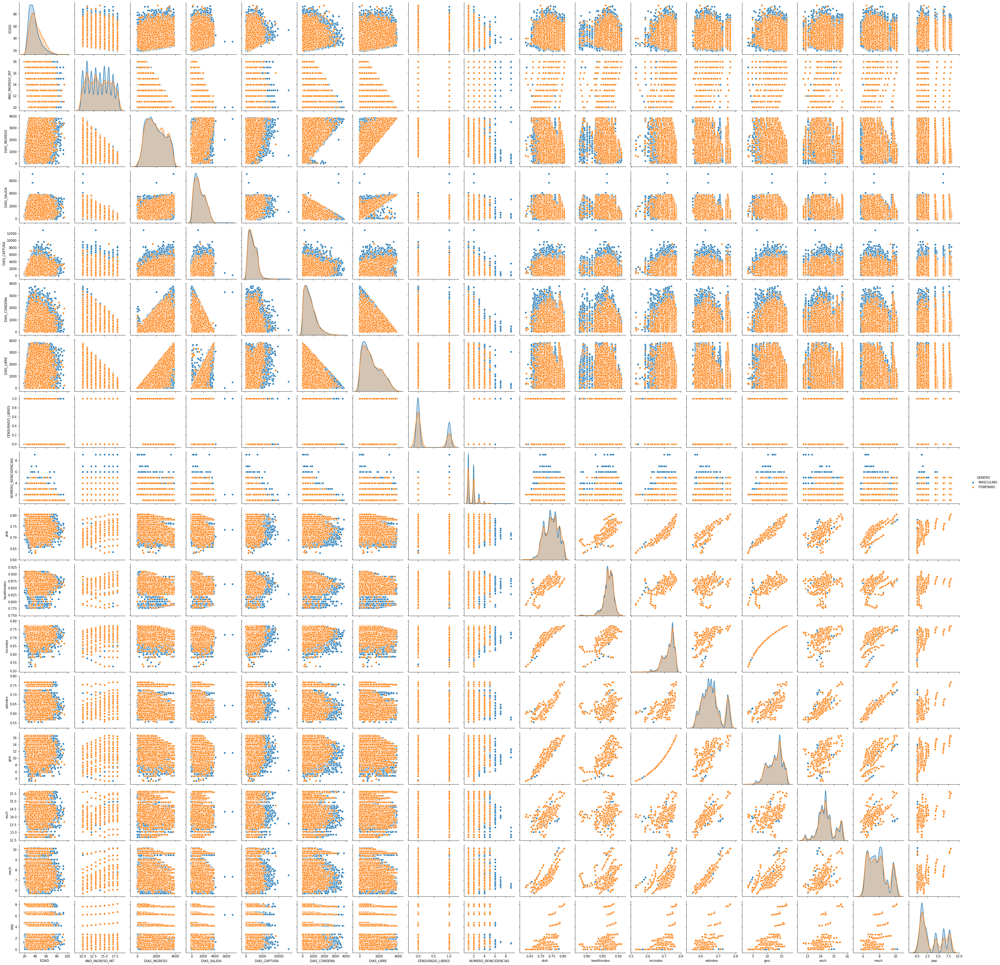

In [26]:
g = sns.pairplot(df_corr, hue="GENERO")


From the previous analysis it is pretty clear that the task won't be easy. Before giving up on these correlations, let's try with a dataframe composed only of the entries from the most frequent crimes in the country.

In [26]:
df_delitos = df_mj_shdi[(df_mj_shdi.TITULO_DELITO == "CONTRA LA SEGURIDAD PUBLICA") |
           (df_mj_shdi.TITULO_DELITO == "CONTRA LA VIDA Y LA INTEGRIDAD PERSONAL") |
           (df_mj_shdi.TITULO_DELITO == "CONTRA EL PATRIMONIO ECONOMICO") & (~df_mj_shdi.DIAS_CONDENA.isna())]

Text(0.5, 1, 'Correlations between numerical variables')

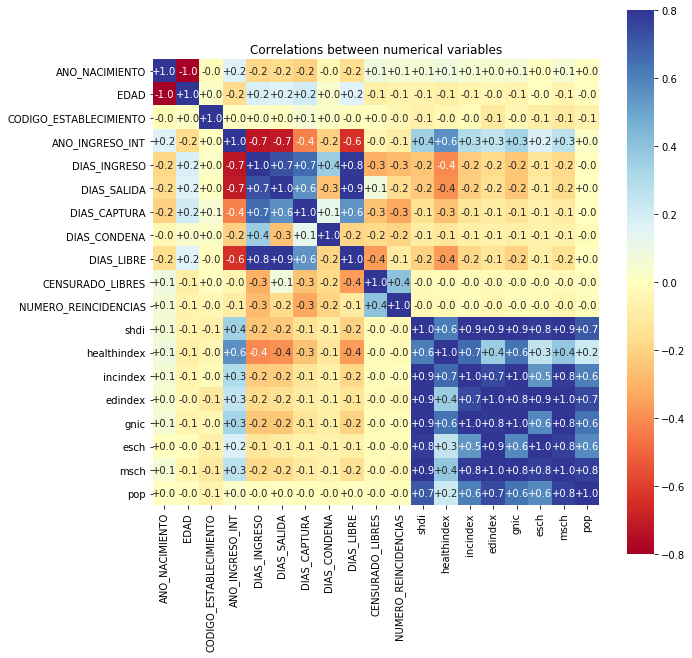

In [43]:
df_delitos.corr()

plt.figure(figsize=(10,10))
sns.heatmap(df_delitos.corr(), cmap="RdYlBu", 
    annot=True, square=True,
    vmin=-0.8, vmax=0.8, fmt="+.1f")
plt.title("Correlations between numerical variables")

## Takeaways from correlation analysis

We could see that most SHDI indexes are highly colinear between them. This tells us that using more than one might not be useful.

We could also see that most of the time variables are highly correlated between them except for the "DIAS_CONDENA" which is the length of the sentence. So, using this and another time variable might be interesting in the models.

Now, another interesting variable to explore is the frequency of the crimes. Since we already know from the EDA that the most committed crimes are theft, drug trafficking and homicide (as was expected from the daily news in Colombia). We decided to calculate the frequency of each crime and take the logarithm. This could be used as a helpful variable for the model or clustering.

In [27]:
delitos_df = pd.DataFrame(df_mj.DELITO.value_counts().sort_values()).reset_index()
delitos_df['logDelito'] = np.log(delitos_df.DELITO) + 1

delitos_df

,index,DELITO,logDelito
0,ACCESO CARNAL VIOLENTO EN PERSONA PROTEGIDA,1,1.000000
1,PARTO O ABORTO PRETERINTENCIONAL,1,1.000000
2,TOMA DE REHENES,1,1.000000
3,FALSIFICACION O USO FRAUDULENTO DE SELLO OFICIAL,1,1.000000
4,"TRÁFICO DE NIÑAS, NIÑOS Y ADOLESCENTES",1,1.000000
...,...,...,...
254,HOMICIDIO,8897,10.093469
255,CONCIERTO PARA DELINQUIR,9864,10.196647
256,FABRICACION TRAFICO Y PORTE DE ARMAS DE FUEGO ...,16816,10.730086
257,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,23923,11.082596


In [36]:
delitos_df[delitos_df.logDelito > 8]

,index,DELITO,logDelito
247,INASISTENCIA ALIMENTARIA,1439,8.271704
248,RECEPTACION,1602,8.379008
249,FABRICACION TRAFICO Y PORTE DE ARMAS Y MUNICI...,1798,8.494430
250,LESIONES PERSONALES,2105,8.652071
251,VIOLENCIA INTRAFAMILIAR,2169,8.682022
252,"FABRICACIÓN, TRÁFICO, PORTE O TENENCIA DE ARMA...",2229,8.709308
253,EXTORSION,2832,8.948738
254,HOMICIDIO,8897,10.093469
255,CONCIERTO PARA DELINQUIR,9864,10.196647
256,FABRICACION TRAFICO Y PORTE DE ARMAS DE FUEGO ...,16816,10.730086


## COX proportional hazards model

**Disclaimer: To check the selected model, jump to section 5**

Now, we want to start trying the cox model.  Initially guided by the pages below:

https://lifelines.readthedocs.io/en/latest/fitters/regression/CoxPHFitter.html <br>
http://www.sthda.com/english/wiki/cox-proportional-hazards-model

Our first try is to take the original dataset after preprocessing (df_mj) with dummy variables. We drop the less important dummies (which are also the less frequent). We could use the process already done in the Time_Analysis notebook. We print the correlation matrix to have it at hand when the model throws some results.

## 1. FIRST TRY: ALL THE COVARIABLES

In [732]:
df_mj['MES_INGRESO_INT'].astype('int64')
df_mj['ANO_INGRESO_INT'].astype('int64')

treat_df = df_mj.drop_duplicates('INTERNOEN')
treat_df = treat_df.loc[treat_df['ACTIVIDADES_ESTUDIO'] == 'SI', ['DIAS_LIBRE', 'EDAD', 'MES_INGRESO_INT', 'ANO_INGRESO_INT', 'DIAS_CONDENA', 'CENSURADO_LIBRES', 'NUMERO_REINCIDENCIAS']]

untreat_df = df_mj[(df_mj['ACTIVIDADES_TRABAJO'] == 'NO') & (df_mj['ACTIVIDADES_ESTUDIO'] == 'NO') & (df_mj['ACTIVIDADES_ENSEÑANZA'] == 'NO')]
untreat_df = untreat_df.loc[untreat_df['INTERNOEN'].isin(set(untreat_df['INTERNOEN']).difference(set(treat_df))), ['DIAS_LIBRE', 'EDAD', 'MES_INGRESO_INT', 'ANO_INGRESO_INT', 'DIAS_CONDENA', 'CENSURADO_LIBRES', 'NUMERO_REINCIDENCIAS']]

dummies_df = pd.get_dummies(df_mj[['ESTADO', 'TENTATIVA', 'AGRAVADO', 'CALIFICADO', 'GENERO', 
                      'REGIONAL', 'ESTADO_INGRESO', 'NIVEL_EDUCATIVO', 'HIJOS_MENORES', 'ESTADO_CIVIL']], drop_first = True)

dummies_df.columns = [string.replace(' ', '_') for string in dummies_df.columns]
dummies_df.columns = [string.replace('(', '_')  for string in dummies_df.columns]
dummies_df.columns = [string.replace(')', '_')  for string in dummies_df.columns]
dummies_df.columns = [string.replace('-', '_')  for string in dummies_df.columns]

treat_df = treat_df.merge(dummies_df, right_index = True, left_index = True)
untreat_df = untreat_df.merge(dummies_df, right_index = True, left_index = True)

drops = list(set(treat_df.columns[np.where(treat_df.std() < 0.1)]).union(set(untreat_df.columns[np.where(untreat_df.std() == 0)])))
print(drops)
treat_df.drop(columns = drops, inplace = True)
untreat_df.drop(columns = drops, inplace = True)

treat_df['treatment'] = 1
untreat_df['treatment'] = 0

df_final = pd.concat([treat_df, untreat_df], axis =0)
df_final = df_final[~df_final['DIAS_CONDENA'].isnull()]

df_cox = df_final[df_final.NUMERO_REINCIDENCIAS <= 2].drop(["ESTADO_Baja","ESTADO_INGRESO_Prision_Domiciliaria",
                   "ESTADO_INGRESO_Vigilancia_Electronica","ANO_INGRESO_INT","MES_INGRESO_INT","GENERO_MASCULINO",
                                 "ESTADO_CIVIL_VIUDO_A_","ESTADO_INGRESO_Espera_Traslado","NUMERO_REINCIDENCIAS"],axis=1)


t=df_mj[["INTERNOEN","DELITO","FECHA_INGRESO","DIAS_CONDENA","NUMERO_REINCIDENCIAS"]].groupby(["INTERNOEN"]).nunique()

df_cox.corr()


['NIVEL_EDUCATIVO_PROFESIONAL', 'NIVEL_EDUCATIVO_TECNICO_PROFESIONAL', 'ESTADO_CIVIL_UNION_LIBRE', 'HIJOS_MENORES_SI', 'ESTADO_CIVIL_RELIGIOSO_A_', 'ESTADO_CIVIL_DIVORCIADO_A_', 'ESTADO_CIVIL_PENDIENTE_POR_', 'NIVEL_EDUCATIVO_POST_GRADO', 'NIVEL_EDUCATIVO_CICLO_IV', 'NIVEL_EDUCATIVO_ESPECIALIZACION', 'NIVEL_EDUCATIVO_TECNICO', 'ESTADO_INGRESO_Detencion_Domiciliaria', 'NIVEL_EDUCATIVO_MAGISTER']


,DIAS_LIBRE,EDAD,DIAS_CONDENA,CENSURADO_LIBRES,TENTATIVA_S,AGRAVADO_S,CALIFICADO_S,REGIONAL_NOROESTE,REGIONAL_NORTE,REGIONAL_OCCIDENTE,REGIONAL_ORIENTE,REGIONAL_VIEJO_CALDAS,ESTADO_INGRESO_Intramuros,NIVEL_EDUCATIVO_CICLO_I,NIVEL_EDUCATIVO_CICLO_II,NIVEL_EDUCATIVO_CICLO_III,NIVEL_EDUCATIVO_TECNOLOGICO,ESTADO_CIVIL_SEPARADO_A_,ESTADO_CIVIL_SOLTERO_A_,treatment
DIAS_LIBRE,1.000000,0.190526,-0.204667,-0.098041,-0.010688,-0.037743,-0.018697,-0.014432,0.003640,-0.037415,-0.012819,0.012970,0.219834,-0.001288,0.019217,-0.021756,0.016488,0.005609,-0.013303,-0.053649
EDAD,0.190526,1.000000,0.064731,-0.071462,-0.021566,-0.128880,-0.250458,-0.019913,-0.032367,-0.023052,-0.034850,0.018529,0.095895,0.080514,0.055753,-0.119257,0.034291,0.025617,-0.084544,0.020853
DIAS_CONDENA,-0.204667,0.064731,1.000000,-0.152941,-0.067742,-0.076573,-0.114379,-0.005353,0.029297,0.022235,-0.004023,-0.019648,-0.039666,0.016129,-0.005018,-0.013956,-0.009435,-0.001491,-0.022932,0.187786
CENSURADO_LIBRES,-0.098041,-0.071462,-0.152941,1.000000,0.028316,0.037741,0.074824,0.070883,0.007647,0.021036,-0.003686,-0.028751,-0.063909,-0.011975,0.001047,0.009367,-0.002543,0.012968,0.080335,-0.549192
TENTATIVA_S,-0.010688,-0.021566,-0.067742,0.028316,1.000000,0.162151,0.115329,-0.000207,0.016595,-0.049833,-0.026665,-0.024767,0.024387,-0.016552,0.006588,0.000116,-0.006520,-0.007777,0.010614,-0.019549
AGRAVADO_S,-0.037743,-0.128880,-0.076573,0.037741,0.162151,1.000000,0.521201,0.027011,0.019828,-0.080447,-0.005857,-0.044679,0.021859,-0.031530,-0.006272,0.025619,-0.012550,-0.005321,0.023276,-0.012586
CALIFICADO_S,-0.018697,-0.250458,-0.114379,0.074824,0.115329,0.521201,1.000000,0.020445,0.006090,-0.093588,0.039920,-0.027964,-0.027779,-0.035245,-0.023712,0.047303,-0.016961,-0.006684,0.055899,-0.034964
REGIONAL_NOROESTE,-0.014432,-0.019913,-0.005353,0.070883,-0.000207,0.027011,0.020445,1.000000,-0.138445,-0.195397,-0.138607,-0.148300,-0.104809,-0.015285,0.015149,0.006035,0.006629,0.003954,-0.005407,-0.089214
REGIONAL_NORTE,0.003640,-0.032367,0.029297,0.007647,0.016595,0.019828,0.006090,-0.138445,1.000000,-0.164826,-0.116921,-0.125098,-0.031874,0.006725,-0.000669,-0.012327,-0.003247,0.000330,0.049534,-0.067067
REGIONAL_OCCIDENTE,-0.037415,-0.023052,0.022235,0.021036,-0.049833,-0.080447,-0.093588,-0.195397,-0.164826,1.000000,-0.165019,-0.176560,0.016385,0.013054,-0.007286,-0.000189,-0.000118,-0.003909,-0.001864,-0.022967


Now, we fit the model using all the covariates and see what happens. The result is a very high c-value (0.89) using 18 covariates, not all of them appear to be statistically significant and 7 variables do not pass the rank nor the KM test for proportionality.

We give a lot of emphasys to this because we want the model to explain the recidivism in Colombia, not to predict the time-to-event. This could be addressed in the future with a lot of care and much more information. As will be seen later, the models are not fitted to predict.

In [51]:
cph = CoxPHFitter(penalizer=0.1)
cph.fit(df_cox, 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES')


<lifelines.CoxPHFitter: fitted with 45452 total observations, 42186 right-censored observations>

In [52]:
cph.print_summary()

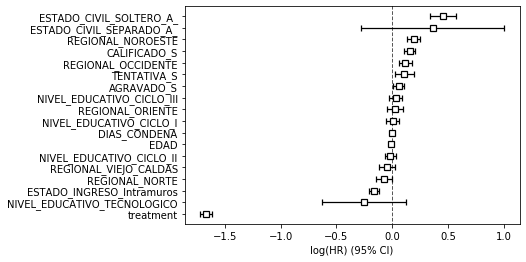

In [53]:
cph.plot()

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'REGIONAL_NORTE' failed the non-proportional test: p-value is 0.0393.

   Advice: with so few unique values (only 2), you can include `strata=['REGIONAL_NORTE', ...]` in
the call in `.fit`. See documentation in link [E] below.

2. Variable 'REGIONAL_ORIENTE' failed the non-proportional test: p-value is 0.0131.

   Advice: with so few unique values (only 2), you can include `strata=['REGIONAL_ORIENTE', ...]` in
the call in `.fit`. See documentation in link [E] below.

3. Variable 'ESTADO_INGRESO_Intramuros' failed the non-proportional test: p-value is <5e-05.

   Advice: with so few unique values (only 2), you can include `strata=['ESTADO_INGRESO_Intramuros',
...]` in the call in `.fit`. See documentation in link [E] below.

4. Variable 'NIVEL_EDUCATIVO_CICLO_III' failed the non-proportional test: p-value is 0.0260.

   Advice: with so few unique values (only 2), you can include `strata=['NIVEL_EDUCATIVO_CICLO_III',
...]` in the call in `.fit`. See documentation in link [E

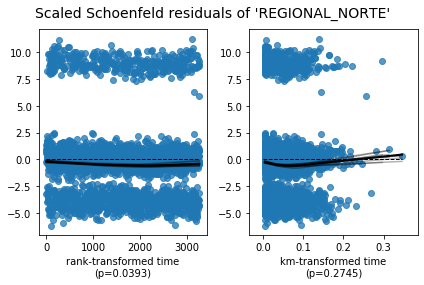

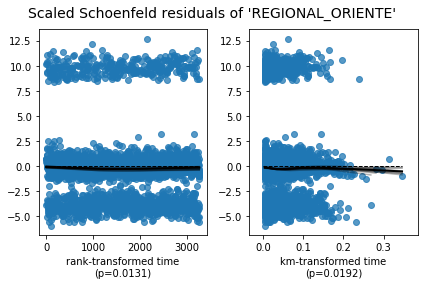

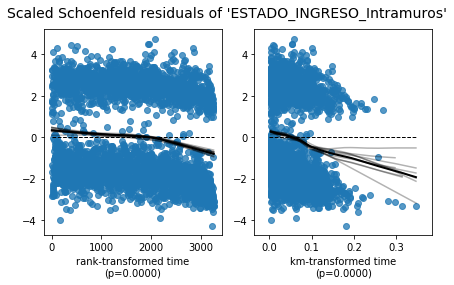

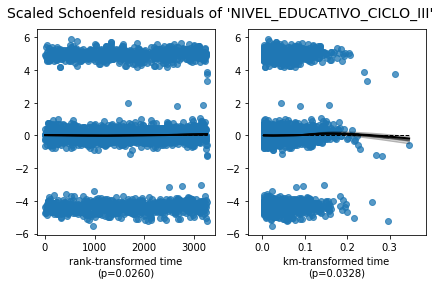

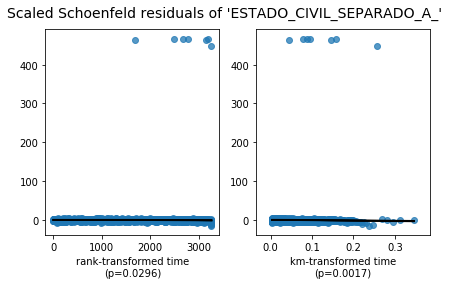

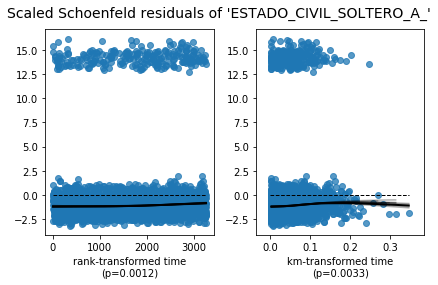

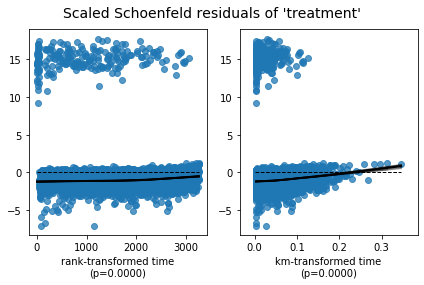

In [100]:
cph.check_assumptions(df_cox, p_value_threshold=0.05, show_plots=True)

# 2. Convert some variables and still use several variables.

The results of the check_assumptions method show a very stratified behavior of the Scaled schoenfeld residuals as well as 
a time dependency. We will perform some transformations on the model to get rid of this problem.

First, we will map the education level to corresponding years of education. Also, convert the YES/NO variables to 0/1.

We will now use also the logarithm of the crime frequency.

Then, select the columns we will work with.

**Important in this model is that we changed the focus of the number of reoffenses. Previously, an individual had assign the total number of reoffenses for all of his entries, this means that a first reoffense would be marked with 5 if that person had reoffended 5 times in the dataset. Now, we mark each reoffense consecutively -> this is done in order to treat each reoffense as if it were a different individual.**

In [735]:
df_cph = df_mj_shdi.copy()

df_cph["educacion"] = 0
nivel_edu = {'ANALFABETA':0 ,'CICLO I':2 , 'CICLO II': 5, 'CICLO III':9, 'CICLO IV':11, 'TECNICO':13, 'TECNOLOGICO':14,
             'TECNICO PROFESIONAL':14 ,'ESPECIALIZACION':17 ,'PROFESIONAL':18, 'MAGISTER':18, 'POST GRADO':18}
for nivel in list(df_cph.NIVEL_EDUCATIVO.unique()):
    df_cph.loc[df_cph["NIVEL_EDUCATIVO"] == nivel,"educacion"] = nivel_edu[nivel]

In [736]:
df_cph["tentativa"] = df_cph.TENTATIVA.map({"N":0,"S":1})
df_cph["agravado"] = df_cph.AGRAVADO.map({"N":0,"S":1})
df_cph["calificado"] = df_cph.CALIFICADO.map({"N":0,"S":1})
df_cph.loc[(df_cph["DELITO"] != "HURTO") & (df_cph["calificado"] == 1)] = 0


In [737]:
df_cph = df_cph.merge(delitos_df[['index', 'logDelito']], left_on = 'DELITO', right_on = 'index')

In [34]:
df_cph.GENERO = df_cph.GENERO.map({"MASCULINO":1,"FEMENINO":0})
df_cph.HIJOS_MENORES = df_cph.HIJOS_MENORES.map({"SI":1,"NO":0})

In [35]:
df_cph.ACTIVIDADES_ENSEÑANZA = df_cph.ACTIVIDADES_ENSEÑANZA.map({"SI":1,"NO":0})
df_cph.ACTIVIDADES_TRABAJO = df_cph.ACTIVIDADES_TRABAJO.map({"SI":1,"NO":0})
df_cph.ACTIVIDADES_ESTUDIO = df_cph.ACTIVIDADES_ESTUDIO.map({"SI":1,"NO":0})

In [36]:
columns=["INTERNOEN","FECHA_INGRESO","DELITO","TITULO_DELITO","EDAD","DEPARTAMENTO","HIJOS_MENORES","ANO_INGRESO_INT",
         "DIAS_INGRESO","DIAS_CAPTURA","DIAS_LIBRE","DIAS_CONDENA","CENSURADO_LIBRES","NUMERO_REINCIDENCIAS","educacion",
        "tentativa","agravado","calificado","logDelito","shdi","pop", "ACTIVIDADES_ESTUDIO","ACTIVIDADES_TRABAJO",
        "ACTIVIDADES_ENSEÑANZA"]

In [37]:
df_maxlogdelito = df_cph[columns].sort_values(by=["INTERNOEN","logDelito"],ascending = False).groupby(["INTERNOEN","FECHA_INGRESO"]).head(1)#.groups

try:
    df_maxlogdelito["shdi"] = df_maxlogdelito["shdi"].apply(lambda x: np.float(x.replace(",",".")))
    df_maxlogdelito["pop"] = df_maxlogdelito["pop"].apply(lambda x: np.float(x.replace(",",".")))
except: 
    None

------------------**Here we calculate the cummulative number of reoffenses**------------------------

In [39]:
df_maxlogdelito["NUM_REINCIDENCIAS_ACUM"] = df_maxlogdelito["NUMERO_REINCIDENCIAS"]

df_maxlogdelito.sort_values(by=["INTERNOEN","FECHA_INGRESO"],ascending = True)

df_maxlogdelito["NUM_REINCIDENCIAS_ACUM"] = df_maxlogdelito.assign(NUM_REINCIDENCIAS_ACUM=df_maxlogdelito.groupby(['INTERNOEN']).cumcount())["NUM_REINCIDENCIAS_ACUM"]+1
df_maxlogdelito

,INTERNOEN,FECHA_INGRESO,DELITO,TITULO_DELITO,EDAD,DEPARTAMENTO,HIJOS_MENORES,ANO_INGRESO_INT,DIAS_INGRESO,DIAS_CAPTURA,DIAS_LIBRE,DIAS_CONDENA,CENSURADO_LIBRES,NUMERO_REINCIDENCIAS,educacion,tentativa,agravado,calificado,logDelito,shdi,pop,ACTIVIDADES_ESTUDIO,ACTIVIDADES_TRABAJO,ACTIVIDADES_ENSEÑANZA,NUM_REINCIDENCIAS_ACUM
0,FFFFB0916FD16C7AF652FF211662005C40F70E33,2016-05-02 00:00:00,FABRICACION TRAFICO Y PORTE DE ARMAS DE FUEGO ...,CONTRA LA SEGURIDAD PUBLICA,29,risaralda,1,16,1551.511357,1641.511365,0.000000,NaN,1,1,11,0,0,0,10.730086,0.753,0.952830,0,1,0,1
34342,FFFF73D0B7088A0EF0A4B7F3CC26F8CF672C6EC1,2016-05-04 00:00:00,HURTO,CONTRA EL PATRIMONIO ECONOMICO,33,bogota,1,16,1549.511357,2094.511365,1424.511357,125.0,0,1,11,0,0,1,11.880779,0.804,7.887584,0,0,0,1
44740,FFFD204514A5DF9EE2F1E36CDBF16F0B79C45590,2015-12-24 00:00:00,"FABRICACIÓN, TRÁFICO, PORTE O TENENCIA DE ARMA...",CONTRA LA SEGURIDAD PUBLICA,53,caldas,1,15,1681.511357,1573.511365,0.000000,NaN,1,1,2,0,0,0,8.709308,0.764,0.976075,0,1,0,1
70493,FFFC9F1A5227DDD6F78179576170997CAAB63AD7,2016-04-14 00:00:00,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,66,tolima,1,16,1569.511357,1570.511365,735.511357,834.0,0,2,5,0,0,0,11.082596,0.739,1.409977,1,1,0,1
90656,FFFC9F1A5227DDD6F78179576170997CAAB63AD7,2011-05-31 00:00:00,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,66,tolima,1,11,1780.000000,2094.000000,1008.000000,772.0,1,2,5,0,0,0,11.082596,0.712,1.426243,1,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26851,0004E9FCF51B47B727F1D6A389B5CD0929344561,2017-07-18 00:00:00,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,26,meta,1,17,1109.511357,1626.511365,898.511357,211.0,0,1,11,0,0,0,11.082596,0.770,0.977043,1,0,0,1
13143,00043EB254F6E5EFCE77A8C20BC709B63A4BE443,2018-08-23 00:00:00,HURTO,CONTRA EL PATRIMONIO ECONOMICO,26,valle del cauca,1,18,708.511357,514.511365,0.000000,NaN,1,1,9,0,1,1,11.880779,0.785,4.760812,0,1,0,1
100799,0003BE212427DF2E9CCB2449B6012EF915B3FAE3,2014-10-24 00:00:00,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,40,antioquia,1,14,2107.511357,2135.511365,1624.511357,483.0,0,1,5,0,0,0,11.082596,0.755,6.329860,1,1,0,1
115205,000393AD7FE65FBBE53A61B0EAA1FB9A62F71450,2013-05-17 00:00:00,HURTO,CONTRA EL PATRIMONIO ECONOMICO,33,guajira,1,13,2632.511357,3753.511365,1727.511357,905.0,0,1,11,0,1,1,11.880779,0.680,0.781191,1,0,0,1


In [177]:
cox_cols=["EDAD","HIJOS_MENORES",                 # "DIAS_CONDENA","DIAS_INGRESO","DIAS_CAPTURA","ANO_INGRESO_INT","pop"
          "DIAS_LIBRE","CENSURADO_LIBRES","NUM_REINCIDENCIAS_ACUM","educacion", "ACTIVIDADES_ESTUDIO","ACTIVIDADES_TRABAJO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito"] #,"shdi"

cph = CoxPHFitter()
cph.fit(df_maxlogdelito.loc[~df_maxlogdelito.DIAS_CONDENA.isna(),cox_cols], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES')


<lifelines.CoxPHFitter: fitted with 86624 total observations, 45365 right-censored observations>

In [178]:
cph.print_summary()

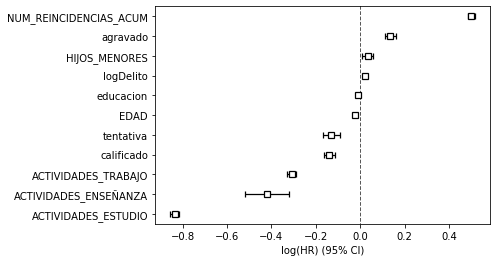

In [179]:
cph.plot()

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'HIJOS_MENORES' failed the non-proportional test: p-value is 0.0027.

   Advice: with so few unique values (only 2), you can include `strata=['HIJOS_MENORES', ...]` in
the call in `.fit`. See documentation in link [E] below.

2. Variable 'ANO_INGRESO_INT' failed the non-proportional test: p-value is <5e-05.

   Advice: with so few unique values (only 9), you can include `strata=['ANO_INGRESO_INT', ...]` in
the call in `.fit`. See documentation in link [E] below.

3. Variable 'DIAS_INGRESO' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'DIAS_INGRESO' might be incorrect. That is, there
may be non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'DIAS_INGRESO' using pd.cut, and then specify it in
`strata=['DIAS_INGRESO', ...]` in the call in `.fit`. See 

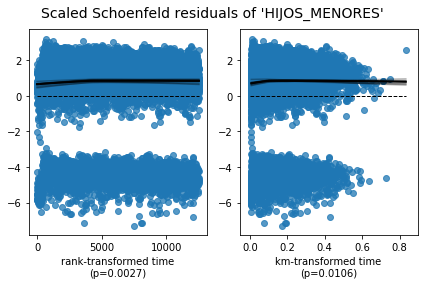

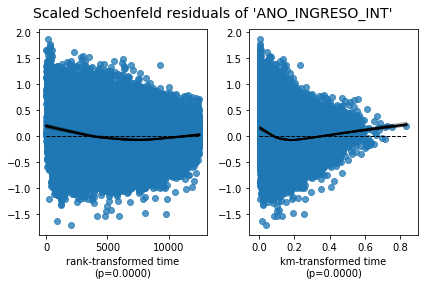

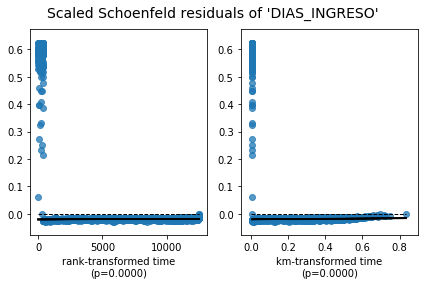

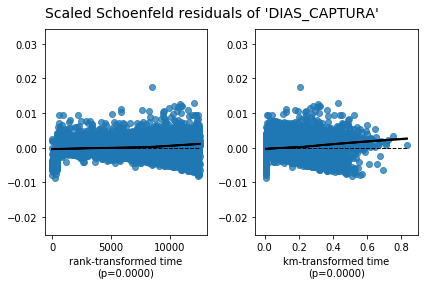

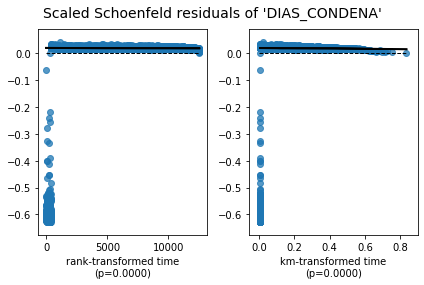

...

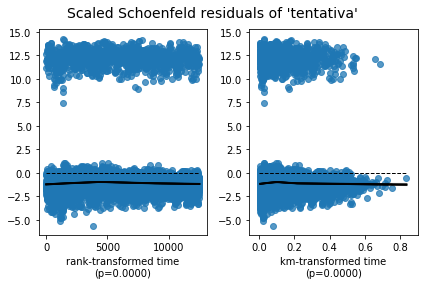

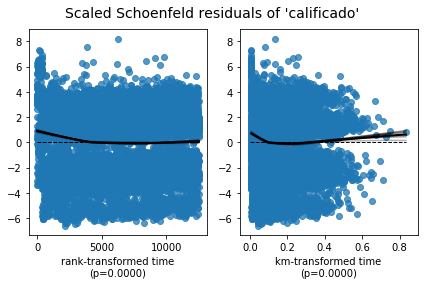

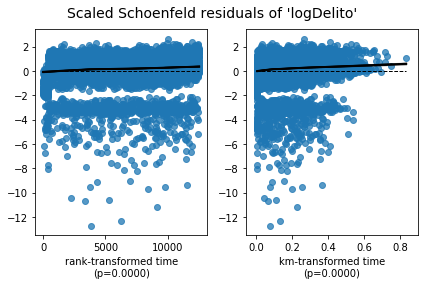

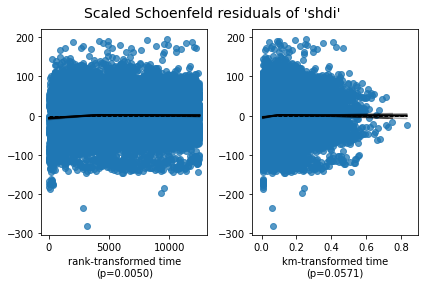

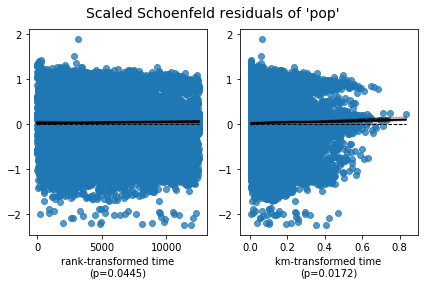

In [229]:
cph.check_assumptions(df_maxlogdelito.loc[~df_maxlogdelito.DIAS_CONDENA.isna(),cox_cols],
                      p_value_threshold=0.05, show_plots=True)

This last model did not work well at all but the residuals had a less messy shape, so, the variables seemed to be in a good direction.

Let's try a third model. This time, we stratify the dataset to consider different baseline hazards for different individuals.

# 3. Model with stratification and several variables.

In [249]:
cph_strata = CoxPHFitter()
cph_strata.fit(df_maxlogdelito.loc[~df_maxlogdelito.DIAS_CONDENA.isna(),cox_cols], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES',
              strata = ["HIJOS_MENORES","tentativa","calificado"])

<lifelines.CoxPHFitter: fitted with 51531 total observations, 39010 right-censored observations>

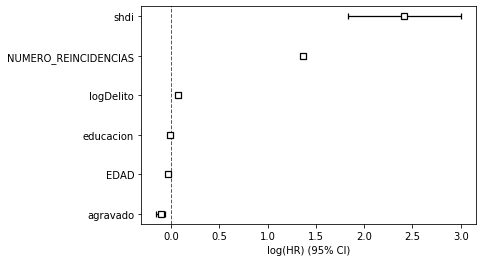

In [250]:
cph_strata.print_summary()
cph_strata.plot()

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'EDAD' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'EDAD' might be incorrect. That is, there may be
non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'EDAD' using pd.cut, and then specify it in `strata=['EDAD',
...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


2. Variable 'NUMERO_REINCIDENCIAS' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'NUMERO_REINCIDENCIAS' might be incorrect. That is,
there may be non-linear terms missing. The proportional hazard test used is very sensitive to
incorrect functional forms. See documentation in link [D] below on how to specify a fu

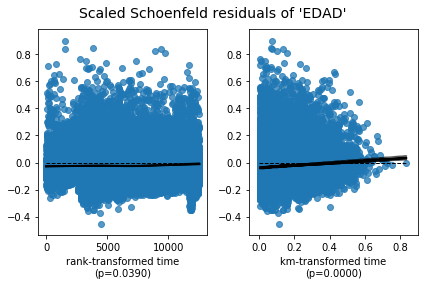

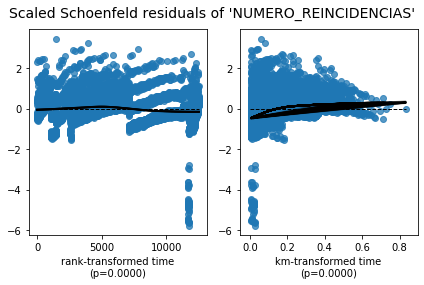

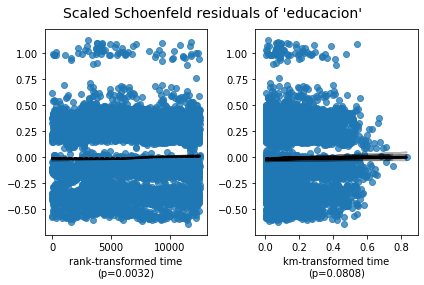

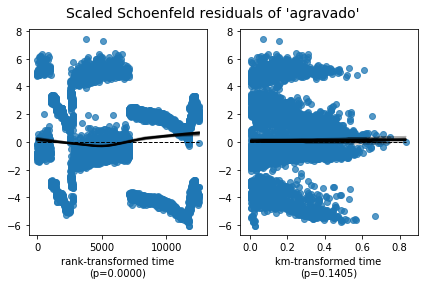

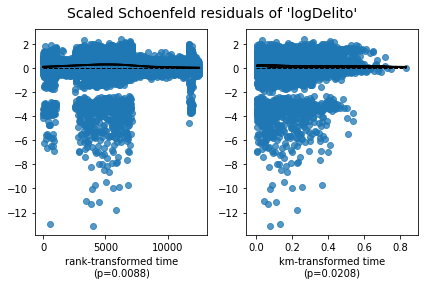

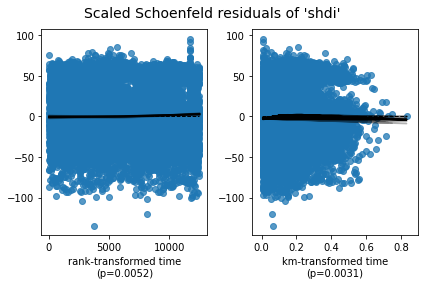

In [251]:
cph_strata.check_assumptions(df_maxlogdelito.loc[~df_maxlogdelito.DIAS_CONDENA.isna(),cox_cols],
                      p_value_threshold=0.05, show_plots=True)

We can see that we gained a lot in c-value (0.88) but once again we lost our improvements in the residuals. It seems that we
cannot avoid the results reported in the literature. We can have a model for prediction that does not provide statistical 
meaning of the variables and is therefore hard to interpret. Or we can search a model that is highly explainable but is not 
fit for prediction.

Since recidivism is not very well understood by the customer, we opt for the second type of model. Prediction could be explored 
in a further model.



# 4. Stratified model that satisfies COX proportionality assumptions.

For this model, the idea is to stratify different variables and try different combinations:

- Bin the age and stratify.
- Use stratification with more variables.

In [278]:
df_maxlog_strata_edad = df_maxlogdelito.copy()
df_maxlog_strata_edad['edad_strata'] = pd.cut(df_maxlog_strata_edad.loc[df_maxlog_strata_edad['EDAD']<73,"EDAD"], np.arange(18, 73, 6))

In [279]:
cox_cols_strata=["EDAD",                # "HIJOS_MENORES","edad_strata","DIAS_CONDENA","DIAS_INGRESO","DIAS_CAPTURA","ANO_INGRESO_INT","pop"
          "DIAS_LIBRE","CENSURADO_LIBRES","NUMERO_REINCIDENCIAS","educacion", "ACTIVIDADES_ESTUDIO",#"ACTIVIDADES_TRABAJO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito"] #,"shdi"

# df_maxlog_strata_edad = df_maxlog_strata_edad.drop('EDAD', axis=1)
df_maxlog_strata_edad = df_maxlog_strata_edad.loc[df_maxlog_strata_edad["educacion"]<16,cox_cols_strata]
# df_maxlog_strata_edad = df_maxlog_strata_edad.loc[~df_maxlog_strata_edad.edad_strata.isna(),cox_cols_strata]
df_maxlog_strata_edad = df_maxlog_strata_edad.loc[df_maxlog_strata_edad.NUMERO_REINCIDENCIAS < 4,cox_cols_strata]



In [198]:
# (df_maxlog_strata_edad.ACTIVIDADES_TRABAJO.isna()).sum()

In [280]:
cph_strata_edad = CoxPHFitter()
cph_strata_edad.fit(df_maxlog_strata_edad[cox_cols_strata], 'DIAS_LIBRE', 
                    event_col = 'CENSURADO_LIBRES', strata = ["NUMERO_REINCIDENCIAS","tentativa","calificado",
                                                              "agravado", "ACTIVIDADES_ESTUDIO","ACTIVIDADES_ENSEÑANZA"
                                                             ]) #"edad_strata","HIJOS_MENORES","educacion"

<lifelines.CoxPHFitter: fitted with 83447 total observations, 44513 right-censored observations>

In [281]:
# df_maxlog_strata_edad.loc[df_maxlog_strata_edad["educacion"]<16,cox_cols_strata]

<lifelines.CoxPHFitter: fitted with 83447 total observations, 44513 right-censored observations>
             duration col = 'DIAS_LIBRE'
                event col = 'CENSURADO_LIBRES'
                   strata = ['NUMERO_REINCIDENCIAS', 'tentativa', 'calificado', 'agravado', 'ACTIVIDADES_ESTUDIO', 'ACTIVIDADES_ENSEÑANZA']
      baseline estimation = breslow
   number of observations = 83447
number of events observed = 38934
   partial log-likelihood = -285841.60
         time fit was run = 2020-08-01 13:46:42 UTC

---
            coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                         
EDAD       -0.02       0.98       0.00            -0.02            -0.02                 0.98                 0.98
educacion  -0.01       0.99       0.00            -0.01            -0.00                 0.99                 1.00
logDelito  -0.03       0.97       0.00            -0.04            -0.02                 0.96                 0.98
               z      p   -log2(p)
covariate                         
EDAD      -35.25 <0.005     901.70
educacion  -4.31 <0.005      15.92
logDelito  -6.89 <0.005      37.43
---
Concordance = 0.59
Partial AIC = 571689.21
log-likelihood ratio test = 1332.97 on 3 df
-log2(p) of ll-ratio test = 956.67

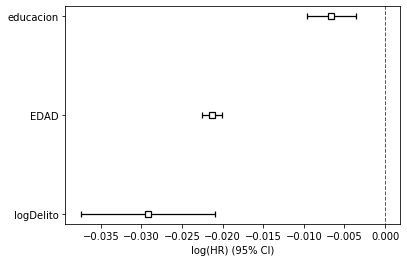

In [282]:
cph_strata_edad.print_summary()
cph_strata_edad.plot()

In [283]:
cph_strata_edad.check_assumptions(df_maxlog_strata_edad[cox_cols_strata], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'EDAD' failed the non-proportional test: p-value is 0.0003.

   Advice 1: the functional form of the variable 'EDAD' might be incorrect. That is, there may be
non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'EDAD' using pd.cut, and then specify it in `strata=['EDAD',
...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


2. Variable 'educacion' failed the non-proportional test: p-value is 0.0548.

   Advice: with so few unique values (only 7), you can include `strata=['educacion', ...]` in the
call in `.fit`. See documentation in link [E] below.

3. Variable 'logDelito' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'logDelito' m

This model is far from perfect but we achieved something interesting: the covariates behave better against the tests except for age in the KM test and logDelito in the Rank test. This is still acceptable and the c-value, despite being the lowest so far, is in the range of common values for survival models (0.55 -0.70). But, is this really a good model? We needed to explore the output of it.

Lifelines allows us to calculate and plot the survival curves of the individuals. We can finally start seeing the impact of the variables.

In [284]:
# pk.dump(cph_strata_edad,open("modelo_COX.pickle","wb"),pk.HIGHEST_PROTOCOL)

In [743]:
cols_pred = ["EDAD",                # "HIJOS_MENORES","edad_strata","DIAS_CONDENA","DIAS_INGRESO","DIAS_CAPTURA","ANO_INGRESO_INT","pop"
          "NUMERO_REINCIDENCIAS","educacion", "ACTIVIDADES_ESTUDIO",#"ACTIVIDADES_TRABAJO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito"] #,"shdi"
tr_rows = df_maxlog_strata_edad.loc[df_maxlog_strata_edad.NUMERO_REINCIDENCIAS == 2,cols_pred].iloc[0:10]
tr_rows

,EDAD,NUMERO_REINCIDENCIAS,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,tentativa,agravado,calificado,logDelito
70493,66,2,5,1,0,0,0,0,11.082596
90656,66,2,5,1,0,0,0,0,11.082596
693,46,2,2,1,0,1,0,1,11.880779
60392,46,2,2,1,0,0,0,0,8.379008
694,21,2,9,0,0,0,1,1,11.880779
119796,31,2,2,1,0,0,0,0,11.082596
119666,31,2,2,1,0,1,0,0,10.093469
2033,34,2,5,1,0,0,0,0,11.880779
56030,30,2,5,1,0,0,0,0,10.093469
72960,30,2,5,1,0,0,0,0,10.093469


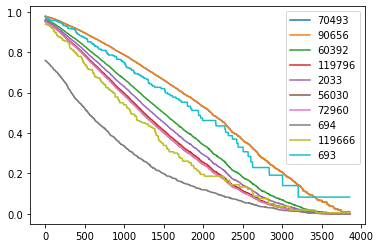

In [745]:
a = pd.DataFrame([[21, 2, 0, 0, 0, 0, 1, 1, 1],[21, 2, 9, 0, 0, 0, 1, 1, 11],[40, 2, 15, 0, 0, 0, 1, 1, 15]])
b = pd.DataFrame([[21, 1, 9, 0, 0, 0, 1, 1, 11],[21, 2, 9, 0, 0, 0, 1, 1, 11],[21, 3, 9, 0, 0, 0, 1, 1, 11]])

a.columns = cols_pred
b.columns = cols_pred

cph_strata_edad.predict_survival_function(tr_rows).plot()


We can clearly see the impact of age and the stratums. We can also see that some groups are not very populated and their survival curve looks more like a ladder (this is common in studies with few samples). We do not want this. So, we will keep trying.


# 5. Model considering time spent in jail or, at least, in sentence.

Now, we want to improve the c-value AND keep satisfying the proportionality test. An idea is to add a more significant variable. We can recall that the sentence length was a non-correlated time variable. It might make sense to use it here. So, we will calculate the acummulated sentences for each reoffense of each individual. 

We also want to define if a person was in jail or not. For this purpose we assign 1 to those who are in jail or waiting for transfer; and assign a 0 for those in house arrest and electronic suveillance.

In [40]:
df_cph.loc[df_cph["DIAS_CONDENA"].isna(),"DIAS_CONDENA"] = (datetime.today() - df_cph["FECHA_INGRESO"])/timedelta(days = 1)

In [42]:
estados = list(df_cph.ESTADO_INGRESO.unique())

df_cph["En_Carcel"] = 0

for estado in ["Intramuros","Espera Traslado","Detencion Domiciliaria"]:
    df_cph.loc[df_cph["ESTADO_INGRESO"] == estado,"En_Carcel"] = 1

In [43]:
df_cph["DIAS_CONDENA_ACUM"] = df_cph.DIAS_CONDENA

df_cph_acum = df_cph.sort_values(by=["INTERNOEN","logDelito"],ascending = False).groupby(['INTERNOEN',
                    'FECHA_INGRESO']).head(1).sort_values(by=["INTERNOEN","FECHA_INGRESO"],
                    ascending = True)

z = df_cph_acum.groupby(["INTERNOEN"]).agg({'DIAS_CONDENA_ACUM':'cumsum'})

df_cph_acum["DIAS_CONDENA_ACUM"] = z

In [44]:
df_cph_acum["NUM_REINCIDENCIAS_ACUM"] = df_cph_acum["NUMERO_REINCIDENCIAS"]

df_cph_acum.sort_values(by=["INTERNOEN","FECHA_INGRESO"],ascending = True)

df_cph_acum["NUM_REINCIDENCIAS_ACUM"] = df_cph_acum.assign(NUM_REINCIDENCIAS_ACUM=df_cph_acum.groupby(['INTERNOEN']).cumcount())["NUM_REINCIDENCIAS_ACUM"]+1

**We use years of sentence and not days of sentence and check how the sentences are distributed in the dataset.**

In [746]:
df_cph_acum["DIAS_CONDENA_ACUM_NORM"] = df_cph_acum.DIAS_CONDENA_ACUM/(30*12)

df_cph_acum['EDAD_STRATA'] = pd.cut(df_cph_acum.loc[df_cph_acum['EDAD']<73,"EDAD"], np.arange(18, 73, 6))
df_cph_acum['DIAS_CONDENA_STRATA'] = df_cph_acum['DIAS_CONDENA_ACUM_NORM'].apply(lambda x: np.floor(x))
df_cph_acum["DIAS_CONDENA_ACUM_NORM"].describe()


count    86624.000000
mean         2.488461
std          1.794564
min          0.000000
25%          1.127778
50%          2.161111
75%          3.427778
max         17.215316
Name: DIAS_CONDENA_ACUM_NORM, dtype: float64

In [747]:
df_cph_acum.head()

,INTERNOEN,DELITO,TITULO_DELITO,SUBTITULO_DELITO,TENTATIVA,AGRAVADO,CALIFICADO,FECHA_INGRESO,FECHA_SALIDA,FECHA_CAPTURA,ANO_NACIMIENTO,EDAD,GENERO,ESTADO_CIVIL,PAIS_INTERNO,DEPARTAMENTO,CIUDAD,ESTADO_INGRESO,ACTIVIDADES_TRABAJO,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NIVEL_EDUCATIVO,HIJOS_MENORES,CONDIC_EXPECIONAL,CODIGO_ESTABLECIMIENTO,...,DIAS_LIBRE,CENSURADO_LIBRES,NUMERO_REINCIDENCIAS,educacion,tentativa,agravado,calificado,index,logDelito,country,shdi,healthindex,incindex,edindex,lifexp,gnic,esch,msch,pop,En_Carcel,DIAS_CONDENA_ACUM,NUM_REINCIDENCIAS_ACUM,DIAS_CONDENA_ACUM_NORM,EDAD_STRATA,DIAS_CONDENA_STRATA
53033,000334541B6B3305CE91761942D7B381248777EA,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,DE LAS AFECTACIONES A LA SALUD PUBLICA,N,N,N,2018-06-08 00:00:00,NaT,2018-02-08 00:00:00,1982,37,1,SEPARADO(A),REPUBLICA DE COLOMBIA,risaralda,LA VIRGINIA-RISARALDA,Intramuros,1,0,0,CICLO IV,1,NaN,142,...,0.000000,1,1,11,0,0,0,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,11.082596,Colombia,0.755,"0,887","0,755","0,643","77,66","14,809212","14,09","7,55",0.982051,1,784.513721,1,2.179205,"(36, 42]",2.0
115205,000393AD7FE65FBBE53A61B0EAA1FB9A62F71450,HURTO,CONTRA EL PATRIMONIO ECONOMICO,DE LA ESTAFA,N,S,S,2013-05-17 00:00:00,2015-11-08 00:00:00,2010-04-22 00:00:00,1987,33,1,NaN,REPUBLICA DE COLOMBIA,guajira,RIOHACHA-LA GUAJIRA,Intramuros,0,1,0,CICLO IV,1,NaN,113,...,1727.511357,0,1,11,0,1,1,HURTO,11.880779,Colombia,0.680,"0,782","0,638","0,63","70,84","6,839884","14,14","7,13",0.781191,1,905.000000,1,2.513889,"(30, 36]",2.0
100799,0003BE212427DF2E9CCB2449B6012EF915B3FAE3,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,DE LAS AFECTACIONES A LA SALUD PUBLICA,N,N,N,2014-10-24 00:00:00,2016-02-19 00:00:00,2014-09-26 00:00:00,1979,40,1,NaN,REPUBLICA DE COLOMBIA,antioquia,MEDELLIN-ANTIOQUIA,Intramuros,1,1,0,CICLO II,1,NaN,128,...,1624.511357,0,1,5,0,0,0,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,11.082596,Colombia,0.755,"0,874","0,743","0,662","76,79","13,716267","14,19","8,04",6.329860,1,483.000000,1,1.341667,"(36, 42]",1.0
13143,00043EB254F6E5EFCE77A8C20BC709B63A4BE443,HURTO,CONTRA EL PATRIMONIO ECONOMICO,DE LA ESTAFA,N,S,S,2018-08-23 00:00:00,NaT,2019-03-05 00:00:00,1993,26,1,SOLTERO(A),REPUBLICA DE COLOMBIA,valle del cauca,SANTIAGO DE CALI-VALLE DEL CAUCA,Intramuros,1,0,0,CICLO III,1,NaN,233,...,0.000000,1,1,9,0,1,1,HURTO,11.880779,Colombia,0.785,"0,892","0,763","0,71","77,95","15,569108","14,7","9,04",4.760812,1,708.513721,1,1.968094,"(24, 30]",1.0
26851,0004E9FCF51B47B727F1D6A389B5CD0929344561,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,CONTRA LA SALUD PUBLICA,DE LAS AFECTACIONES A LA SALUD PUBLICA,N,N,N,2017-07-18 00:00:00,2018-02-14 00:00:00,2016-02-17 00:00:00,1994,26,1,NaN,REPUBLICA DE COLOMBIA,meta,VILLAVICENCIO-META,Intramuros,0,1,0,CICLO IV,1,NaN,130,...,898.511357,0,1,11,0,0,0,TRAFICO FABRICACION O PORTE DE ESTUPEFACIENTES,11.082596,Colombia,0.770,"0,908","0,737","0,682","78,99","13,147209","14,34","8,51",0.977043,1,211.000000,1,0.586111,"(24, 30]",0.0


Since most individuals don't reoffend more than 4 times during the duration of the study (10 years so far), we remove those few individuals with more than 4 accumulated reoffenses (so we keep their initial 4 reoffenses) and we remove individuals with more
than 16 years of education, since there less than 100 of them.

In [271]:
cox_cols_strata_acum=["EDAD", 
          "DIAS_LIBRE","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO",       
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito",      
                "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM"]          
try:
    df_cph_acum["shdi"] = df_cph_acum["shdi"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_acum["pop"] = df_cph_acum["pop"].apply(lambda x: np.float(x.replace(",",".")))
except:
    None
    
df_cph_acum_trim = df_cph_acum.loc[df_cph_acum["educacion"]<16,cox_cols_strata_acum]
df_cph_acum_trim = df_cph_acum_trim.loc[df_cph_acum_trim.NUM_REINCIDENCIAS_ACUM < 5,cox_cols_strata_acum]

In [274]:
cph_acum = CoxPHFitter()

cph_acum.fit(df_cph_acum_trim[cox_cols_strata_acum], 'DIAS_LIBRE', 
                    event_col = 'CENSURADO_LIBRES', strata = ["NUM_REINCIDENCIAS_ACUM","tentativa","calificado",
                                                              "agravado", "ACTIVIDADES_ESTUDIO","ACTIVIDADES_ENSEÑANZA"
                                                             , "En_Carcel"],robust=True) 

<lifelines.CoxPHFitter: fitted with 85583 total observations, 44690 right-censored observations>

<lifelines.CoxPHFitter: fitted with 85583 total observations, 44690 right-censored observations>
             duration col = 'DIAS_LIBRE'
                event col = 'CENSURADO_LIBRES'
          robust variance = True
                   strata = ['NUM_REINCIDENCIAS_ACUM', 'tentativa', 'calificado', 'agravado', 'ACTIVIDADES_ESTUDIO', 'ACTIVIDADES_ENSEÑANZA', 'En_Carcel']
      baseline estimation = breslow
   number of observations = 85583
number of events observed = 40893
   partial log-likelihood = -297438.60
         time fit was run = 2020-08-01 13:44:39 UTC

---
                         coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                                      
EDAD                    -0.03       0.97       0.00            -0.03            -0.03                 0.97                 0.97
educacion               -0.01       0.99       0.00            -0.01            -0.00                 0.99                 1.00
logDelito                0.01       1.01       0.00             0.01             0.02                 1.01                 1.02
DIAS_CONDENA_ACUM_NORM   0.23       1.26       0.00             0.22             0.23                 1.25                 1.26
                            z      p   -log2(p)
covariate                                      
EDAD                   -42.48 <0.005        inf
educacion               -3.78 <0.005      12.65
logDelito                3.22 <0.005       9.62
DIAS_CONDENA_ACUM_NORM  85.84 <0.005        inf
---
Concordance = 0.66
Partial AIC = 594885.19
log-likelihood ratio test = 7811.40 on 4 df
-log2(p) of ll-ratio test = inf

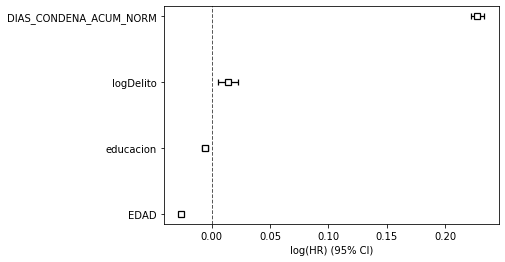

In [275]:
cph_acum.print_summary()
cph_acum.plot()

In [276]:
cph_acum.check_assumptions(df_cph_acum_trim[cox_cols_strata_acum], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'logDelito' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'logDelito' might be incorrect. That is, there may
be non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'logDelito' using pd.cut, and then specify it in
`strata=['logDelito', ...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


2. Variable 'DIAS_CONDENA_ACUM_NORM' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'DIAS_CONDENA_ACUM_NORM' might be incorrect. That
is, there may be non-linear terms missing. The proportional hazard test used is very sensitive to
incorrect functional forms. See documentation in link [D] belo

<br>
We can see that we improved our c-value to a decent level for a survival model according to literature. Nevertheless, two of our 4 covariates still miss the proportional tests. We will, nevertheless plot the curves to see how they look. From this, we can see that we are still not good... In fact, the groups seem to have very few individuals, we are probably fitting a model in groups of less than 100 or 200 individuals. Also, these curves cross a lot inside the same group and this seems quite strange. We must keep on trying and check if some other models replicate this.
</br>


In [ ]:
# pk.dump(cph_acum,open("modelo_COX_shdi.pickle","wb"),pk.HIGHEST_PROTOCOL)

In [749]:
cols_acum_predict=["EDAD", #"GENERO",#"DIAS_CONDENA_STRATA",   # "EDAD_STRATA","HIJOS_MENORES","edad_strata","DIAS_CONDENA","DIAS_INGRESO","DIAS_CAPTURA","ANO_INGRESO_INT","pop"
          "educacion", "ACTIVIDADES_ESTUDIO",       #"ACTIVIDADES_TRABAJO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito",      #"pop",
                "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM"]          #,"shdi"
tr_rows = df_cph_acum_trim.loc[df_cph_acum_trim.NUM_REINCIDENCIAS_ACUM == 2,cols_acum_predict].iloc[0:5]
tr_rows

,EDAD,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,tentativa,agravado,calificado,logDelito,NUM_REINCIDENCIAS_ACUM,En_Carcel,DIAS_CONDENA_ACUM_NORM
32651,35,11,1,1,0,0,0,10.196647,2,1,3.291667
87727,40,2,1,0,0,1,0,11.880779,2,0,3.466667
94394,40,2,1,0,0,1,1,11.880779,2,1,3.247222
67301,92,2,1,0,0,0,0,11.082596,2,0,2.769444
111157,34,2,1,0,0,1,1,11.880779,2,0,1.105556


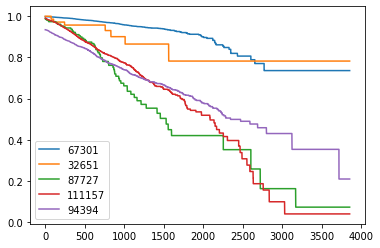

In [750]:
a = pd.DataFrame([[21, 1, 1, 0, 0, 0, 1, 1, 11,2,1,1],[21, 1, 9, 0, 0, 0, 1, 1, 11,2,1,2],[21, 1, 14, 0, 0, 0, 1, 1, 11,2,1,3]])
b = pd.DataFrame([[21, 1, 9, 0, 0, 0, 1, 1, 11],[21, 2, 9, 0, 0, 0, 1, 1, 11],[21, 3, 9, 0, 0, 0, 1, 1, 11]])

cph_acum.predict_survival_function(tr_rows).plot()

# 6. Model considering SHDI.

After several tries, we notice that the stratums we are creating are not satisfying. We are not going anywhere. In this model, we use the SHDI global value, population, msch (mean years of schooling), gnic (gross national income per capita) and see which one works better.

We experiment with them as covariates and as stratum.

During the trials, we notice that population has impact on the model but this is not linear. In fact, after some trials, we see that population is more significant when a cubic transformation is used. More precisely, we calculate (pop - average pop)^3 to avoid huge numbers. This is also interesting because we can see the impact of those regions with lower population than the average and those with higher than the average.

In this model we also tried normalizing the education years with the msch but the results were not good so we omit that trial.

In [77]:
df_cox_shdi = df_cph_acum.copy()

cox_shdi=["EDAD", "NUMERO_REINCIDENCIAS",#"GENERO",#"DIAS_CONDENA_STRATA",   # "EDAD_STRATA","HIJOS_MENORES","edad_strata","DIAS_CONDENA","DIAS_INGRESO","DIAS_CAPTURA","ANO_INGRESO_INT","pop"
          "DIAS_LIBRE","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO",       #"ACTIVIDADES_TRABAJO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito","pop",
                "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic","msch","shdi"]          
try:
    df_cox_shdi["gnic"] = df_cox_shdi["gnic"].apply(lambda x: np.float(x.replace(",",".")))
    df_cox_shdi["msch"] = df_cox_shdi["msch"].apply(lambda x: np.float(x.replace(",",".")))
    df_cox_shdi["pop"] = df_cox_shdi["pop"].apply(lambda x: np.float(x.replace(",",".")))
except:
    None
    
df_cox_shdi = df_cox_shdi.loc[df_cox_shdi["educacion"]<16,cox_shdi]

df_cox_shdi = df_cox_shdi.loc[df_cox_shdi.NUM_REINCIDENCIAS_ACUM < 5,cox_shdi]
df_cox_shdi = df_cox_shdi.loc[df_cox_shdi["DIAS_CONDENA_ACUM_NORM"]<9,cox_shdi]

df_cox_shdi["gnic_strata"] = df_cox_shdi["gnic"].apply(lambda x: 1 if x > 13.3 else 0)
# df_cox_shdi['gnic_strata'] = pd.cut(df_cox_shdi['gnic'], [0,13.3,17])
# df_cox_shdi['shdi_strata'] = pd.cut(df_cox_shdi['shdi'], [0.6,0.73,0.77,0.81])
df_cox_shdi['pop_strata'] = pd.cut(df_cox_shdi['pop'], [0,1.5,3.5,9])
df_cox_shdi['cond_strata'] = pd.cut(df_cox_shdi['DIAS_CONDENA_ACUM_NORM'], [0,1.5,3.5,10])
df_cox_shdi["pop**2"] = (df_cox_shdi["pop"]-df_cox_shdi["pop"].mean())**2
df_cox_shdi["pop**3"] = (df_cox_shdi["pop"]-df_cox_shdi["pop"].mean())**3
df_cox_shdi["cond**2"] = (df_cox_shdi["DIAS_CONDENA_ACUM_NORM"]/df_cox_shdi["DIAS_CONDENA_ACUM_NORM"].mean())**2
df_cox_shdi["cond"] = (df_cox_shdi["DIAS_CONDENA_ACUM_NORM"]-df_cox_shdi["DIAS_CONDENA_ACUM_NORM"].mean())
df_cox_shdi["edu_norm"] = df_cox_shdi["educacion"]/df_cox_shdi["msch"]

In [608]:
df_cox_shdi

,EDAD,NUMERO_REINCIDENCIAS,DIAS_LIBRE,CENSURADO_LIBRES,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,tentativa,agravado,calificado,logDelito,pop,NUM_REINCIDENCIAS_ACUM,En_Carcel,DIAS_CONDENA_ACUM_NORM,gnic,msch,shdi,gnic_strata,pop_strata,cond_strata,pop**2,pop**3,cond**2,cond,edu_norm
53033,37,1,0.000000,1,11,0,0,0,0,0,11.082596,0.982051,1,1,2.179205,14.809212,7.55,0.755,1,"(0.0, 1.5]","(1.5, 3.5]",5.684679,-13.553734,0.783169,-0.283262,1.456954
115205,33,1,1727.511357,0,11,1,0,0,1,1,11.880779,0.781191,1,1,2.513889,6.839884,7.13,0.680,0,"(0.0, 1.5]","(1.5, 3.5]",6.682828,-17.275888,1.042201,0.051422,1.542777
100799,40,1,1624.511357,0,5,1,0,0,0,0,11.082596,6.329860,1,1,1.341667,13.716267,8.04,0.755,1,"(3.5, 9.0]","(0.0, 1.5]",8.782643,26.027823,0.296858,-1.120800,0.621891
13143,26,1,0.000000,1,9,0,0,0,1,1,11.880779,4.760812,1,1,1.968094,15.569108,9.04,0.785,1,"(3.5, 9.0]","(1.5, 3.5]",1.944643,2.711813,0.638779,-0.494373,0.995575
26851,26,1,898.511357,0,11,1,0,0,0,0,11.082596,0.977043,1,1,0.586111,13.147209,8.51,0.770,0,"(0.0, 1.5]","(0.0, 1.5]",5.708585,-13.639320,0.056653,-1.876355,1.292597
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90656,66,2,1008.000000,1,5,1,0,0,0,0,11.082596,1.426243,1,1,2.144444,10.079057,6.56,0.712,0,"(0.0, 1.5]","(1.5, 3.5]",3.763850,-7.302113,0.758384,-0.318022,0.762195
70493,66,2,735.511357,0,5,1,0,0,0,0,11.082596,1.409977,2,1,4.461111,11.143699,7.21,0.739,0,"(0.0, 1.5]","(3.5, 10.0]",3.827229,-7.487326,3.282052,1.998645,0.693481
44740,53,1,0.000000,1,2,0,0,0,0,0,8.709308,0.976075,1,0,4.670871,14.576948,7.82,0.764,1,"(0.0, 1.5]","(3.5, 10.0]",5.713212,-13.655905,3.597950,2.208405,0.255754
34342,33,1,1424.511357,0,11,0,0,0,0,1,11.880779,7.887584,1,0,0.347222,16.668069,10.04,0.804,1,"(3.5, 9.0]","(0.0, 1.5]",20.441941,92.423665,0.019883,-2.115244,1.095618


In [50]:
df_cox_shdi.gnic.describe()
df_cox_shdi["pop**3"].describe()

count    85281.000000
mean        10.127889
std         34.019587
min        -37.565841
25%         -9.795049
50%         -1.905953
75%         23.666216
max        108.065687
Name: pop**3, dtype: float64

In [51]:
df_cox_shdi["pop"].describe()

count    85281.000000
mean         3.366308
std          2.581503
min          0.017185
25%          1.226693
50%          2.126453
75%          6.237372
max          8.129476
Name: pop, dtype: float64

In [52]:
df_cox_shdi.DIAS_CONDENA_ACUM_NORM.describe()

count    85281.000000
mean         2.462466
std          1.742818
min          0.000000
25%          1.127778
50%          2.152778
75%          3.405556
max          8.994444
Name: DIAS_CONDENA_ACUM_NORM, dtype: float64

In [53]:
df_cox_shdi.edu_norm.describe()

count    85281.000000
mean         0.795025
std          0.445139
min          0.000000
25%          0.498008
50%          0.701262
75%          1.150895
max          2.385009
Name: edu_norm, dtype: float64

In [79]:
cox_shdi=["EDAD", "DIAS_LIBRE","tentativa","agravado","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"calificado","NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3"]      

cph_shdi = CoxPHFitter()

cph_shdi.fit(df_cox_shdi[cox_shdi], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES',   
  strata = ["NUM_REINCIDENCIAS_ACUM", "En_Carcel","gnic_strata",           #,"pop_strata","ACTIVIDADES_ENSEÑANZA","NUM_REINCIDENCIAS_ACUM",
  "ACTIVIDADES_ENSEÑANZA","ACTIVIDADES_ESTUDIO","tentativa","agravado","calificado"],robust=True) #,"calificado", "En_Carcel"

<lifelines.CoxPHFitter: fitted with 85281 total observations, 44642 right-censored observations>

<lifelines.CoxPHFitter: fitted with 85281 total observations, 44642 right-censored observations>
             duration col = 'DIAS_LIBRE'
                event col = 'CENSURADO_LIBRES'
          robust variance = True
                   strata = ['NUM_REINCIDENCIAS_ACUM', 'En_Carcel', 'gnic_strata', 'ACTIVIDADES_ENSEÑANZA', 'ACTIVIDADES_ESTUDIO', 'tentativa', 'agravado', 'calificado']
      baseline estimation = breslow
   number of observations = 85281
number of events observed = 40639
   partial log-likelihood = -268026.83
         time fit was run = 2020-07-31 18:22:59 UTC

---
                         coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                                      
EDAD                    -0.03       0.98       0.00            -0.03            -0.02                 0.97                 0.98
educacion               -0.01       0.99       0.00            -0.01            -0.00                 0.99                 1.00
DIAS_CONDENA_ACUM_NORM   0.23       1.26       0.00             0.23             0.24                 1.26                 1.27
pop**3                  -0.00       1.00       0.00            -0.00            -0.00                 1.00                 1.00
                            z      p   -log2(p)
covariate                                      
EDAD                   -40.88 <0.005        inf
educacion               -5.08 <0.005      21.34
DIAS_CONDENA_ACUM_NORM  81.31 <0.005        inf
pop**3                  -9.28 <0.005      65.65
---
Concordance = 0.65
Partial AIC = 536061.67
log-likelihood ratio test = 7385.98 on 4 df
-log2(p) of ll-ratio test = inf

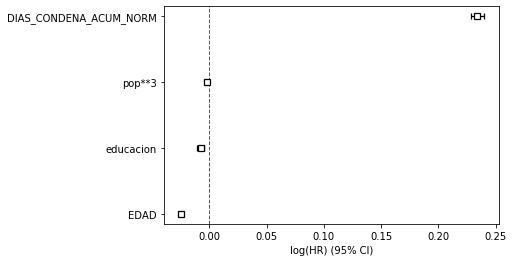

In [80]:
cph_shdi.print_summary()
cph_shdi.plot()

In [81]:
cph_shdi.check_assumptions(df_cox_shdi[cox_shdi], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'EDAD' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'EDAD' might be incorrect. That is, there may be
non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'EDAD' using pd.cut, and then specify it in `strata=['EDAD',
...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


2. Variable 'DIAS_CONDENA_ACUM_NORM' failed the non-proportional test: p-value is <5e-05.

   Advice 1: the functional form of the variable 'DIAS_CONDENA_ACUM_NORM' might be incorrect. That
is, there may be non-linear terms missing. The proportional hazard test used is very sensitive to
incorrect functional forms. See documentation in link [D] below on how to specify 

# This model gave us some very interesting results!
<br> <br>
We see that when using population as a covariate and gnic as a stratum, we preserve the c-value and perform better in the proportionality tests. We plot the survival curves and shamefully we see that the groups are scarsely populated. Nevertheless, at this point, we saw that the effect of covariates was preserved in most models and the trend seemed right. Therefore, we now only wish for a model with a similar c-value but with much more populated groups!!!

In [488]:
# pk.dump(cph_shdi,open("modelo_COX_shdi.pickle","wb"),pk.HIGHEST_PROTOCOL)

In [751]:
cox_shdi_predict=["EDAD","tentativa","agravado","calificado","educacion", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
                  "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3"]      

tr_rows = df_cox_shdi.loc[df_cox_shdi.NUM_REINCIDENCIAS_ACUM == 2,cox_shdi_predict].iloc[0:10]
tr_rows

,EDAD,tentativa,agravado,calificado,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NUM_REINCIDENCIAS_ACUM,En_Carcel,DIAS_CONDENA_ACUM_NORM,gnic_strata,pop**3
32651,35,0,0,0,11,1,1,2,1,3.291667,1,35.791927
87727,40,0,1,0,2,1,0,2,0,3.466667,1,-14.284320
94394,40,0,1,1,2,1,0,2,1,3.247222,0,24.361874
67301,92,0,0,0,2,1,0,2,0,2.769444,1,32.621912
111157,34,0,1,1,2,1,0,2,0,1.105556,0,-0.303074
39056,37,0,1,1,5,0,0,2,0,2.058333,1,86.042178
17177,30,0,0,1,5,1,0,2,1,4.672222,1,1.687069
8293,25,0,0,0,11,1,0,2,1,2.452778,1,2.314716
105690,28,0,1,1,5,0,0,2,1,0.836111,0,-11.421720
1196,34,0,0,1,5,1,0,2,0,5.191667,1,-2.057467


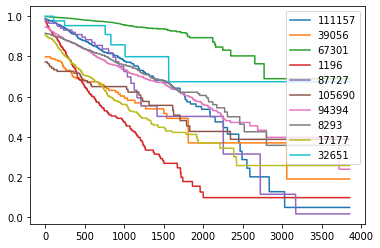

In [752]:
a = pd.DataFrame([[21, 1, 1, 1, 0, 0, 1, 1, 0,1,15,0],[21, 1, 1, 1, 0, 0, 1, 1, 0,1,15,0],[21, 1, 1, 1, 0, 0, 1, 1, 0,1,15,0]])
b = pd.DataFrame([[21, 1, 9, 0, 0, 0, 1, 1, 11],[21, 2, 9, 0, 0, 0, 1, 1, 11],[21, 3, 9, 0, 0, 0, 1, 1, 11]])

a.columns = cox_shdi_predict

cph_shdi.predict_survival_function(tr_rows).plot()

In [491]:
cox_shdi=["EDAD", "DIAS_LIBRE","tentativa","agravado","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"calificado","NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3"]      

### Here, we explored the prediction of time-to-event with our model with not very good results. It was worth trying.

Below we can find a deeper exploration of the impact of the covariates in the different groups.

In [502]:
_predict = cph_shdi.predict_expectation(df_cox_shdi.loc[df_cox_shdi.NUM_REINCIDENCIAS_ACUM==1,cox_shdi].iloc[0:10000])#,conditional_after=np.ones(16829)*3000)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002365869F430>]],
      dtype=object)

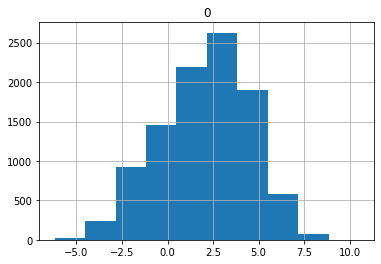

In [503]:
dif = pd.DataFrame((_predict - df_cox_shdi.loc[df_cox_shdi.NUM_REINCIDENCIAS_ACUM==1,cox_shdi].iloc[0:10000].DIAS_LIBRE)/(30*12))
dif[dif[0]!=np.inf].hist()

In [504]:
dif[dif[0]!=np.inf].describe()

,0
count,10000.000000
mean,2.051344
std,2.451925
min,-6.193201
25%,0.367705
50%,2.284428
75%,3.871033
max,10.511111


In [153]:
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 1
attempt = 0
aggrav = 0
qualif = 0

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()

test = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test.columns = cox_shdi_predict

survival_df = cph_shdi.predict_survival_function(test).reset_index()
survival_df
#-----------------------------------
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0
attempt = 0
aggrav = 0
qualif = 0

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()


test2 = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test2.columns = cox_shdi_predict

survival_df2 = cph_shdi.predict_survival_function(test2).reset_index()
survival_df2
#-----------------------------
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=survival_df["index"]/30, y=survival_df[0], name="Study in Jail",line_shape='vhv',
        line_color="red",
#         name=name,
    showlegend=True
    ))

fig.add_trace(go.Scatter(
        x=survival_df2["index"]/30, y=survival_df2[0], name="Not study in Jail",line_shape='vhv',
#         line_color=line_color_l,
#         name=name,
    line_color="blue",
    showlegend=True
    ))

fig.update_layout(
    xaxis_title ="Months",
    yaxis_title = "P(t > T)",
    title = 'Probability of not returning to jail',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


In [154]:
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0
attempt = 0
aggrav = 0
qualif = 0

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()

test = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test.columns = cox_shdi_predict

survival_df = cph_shdi.predict_survival_function(test).reset_index()
survival_df
#-----------------------------------
jail = 0
gnic = 0
recidiv = 1
teach = 0
study = 0
attempt = 0
aggrav = 0
qualif = 0

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()


test2 = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test2.columns = cox_shdi_predict

survival_df2 = cph_shdi.predict_survival_function(test2).reset_index()
survival_df2
#-----------------------------
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=survival_df["index"]/30, y=survival_df[0], name="Condemned in Jail",line_shape='vhv',
        line_color="red",
#         name=name,
    showlegend=True
    ))

fig.add_trace(go.Scatter(
        x=survival_df2["index"]/30, y=survival_df2[0], name="House arrest",line_shape='vhv',
#         line_color=line_color_l,
#         name=name,
    line_color="blue",
    showlegend=True
    ))

fig.update_layout(
    xaxis_title ="Months",
    yaxis_title = "P(t > T)",
    title = 'Probability of not returning to jail',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


In [155]:
jail = 1
gnic = 1
recidiv = 1
teach = 0
study = 0
attempt = 0
aggrav = 0
qualif = 0

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()

test = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test.columns = cox_shdi_predict

survival_df = cph_shdi.predict_survival_function(test).reset_index()
survival_df
#-----------------------------------
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0
attempt = 0
aggrav = 0
qualif = 0

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()


test2 = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test2.columns = cox_shdi_predict

survival_df2 = cph_shdi.predict_survival_function(test2).reset_index()
survival_df2
#-----------------------------
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=survival_df["index"]/30, y=survival_df[0], name="High gnic",line_shape='vhv',
        line_color="red",
#         name=name,
    showlegend=True
    ))

fig.add_trace(go.Scatter(
        x=survival_df2["index"]/30, y=survival_df2[0], name="Low gnic",line_shape='vhv',
#         line_color=line_color_l,
#         name=name,
    line_color="blue",
    showlegend=True
    ))

fig.update_layout(
    xaxis_title ="Months",
    yaxis_title = "P(t > T)",
    title = 'Probability of not returning to jail',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


In [163]:
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0
attempt = 0
aggrav = 1
qualif = 1

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()

test = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test.columns = cox_shdi_predict

survival_df = cph_shdi.predict_survival_function(test).reset_index()
survival_df
#-----------------------------------
jail = 1
gnic = 0
recidiv = 2
teach = 0
study = 0
attempt = 0
aggrav = 1
qualif = 1

target_group = df_cox_shdi.loc[(df_cox_shdi.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cox_shdi.En_Carcel == jail) & \
                (df_cox_shdi.gnic_strata == gnic) & (df_cox_shdi.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cox_shdi.ACTIVIDADES_ESTUDIO == study) & (df_cox_shdi.tentativa == attempt) & \
                (df_cox_shdi.agravado == aggrav) & (df_cox_shdi.calificado == qualif), cox_shdi_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()


test2 = pd.DataFrame([[age_mean,attempt,aggrav,qualif,educ_mean,study,teach,recidiv,jail,condemn_mean,gnic,pop_mean]])
test2.columns = cox_shdi_predict

survival_df2 = cph_shdi.predict_survival_function(test2).reset_index()
survival_df2
#-----------------------------
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=survival_df["index"]/30, y=survival_df[0], name="First recidivism",line_shape='vhv',
        line_color="red",
#         name=name,
    showlegend=True
    ))

fig.add_trace(go.Scatter(
        x=survival_df2["index"]/30, y=survival_df2[0], name="Second recidivism",line_shape='vhv',
#         line_color=line_color_l,
#         name=name,
    line_color="blue",
    showlegend=True
    ))

fig.update_layout(
    xaxis_title ="Months",
    yaxis_title = "P(t > T)",
    title = 'Probability of not returning to jail',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()

# 7. The final models...using the clusters and some creativity

# 7.1 Using t-SNE clusters as input for the COX model.

Here, we proceed as before, except that we added the cluster for each intern entry and used this as a cluster parameter in the cox model fitter.

First, we read the csv file containing the intern + cluster data.

Then, we merge the recidivism and the cluster dataframes and fit the model.

In [168]:
url="https://raw.githubusercontent.com/sagilar/ds4a-team6/master/retomintic/cluster.csv"
clusters_df = pd.read_csv(url, sep=",",encoding="utf-8")

In [192]:
clusters_df

# df_cox_shdi
df_cph_clusters = df_cph_acum.merge(clusters_df[["INTERNOEN","cluster"]], on = "INTERNOEN")

In [193]:
cox_clusters=["EDAD", "NUMERO_REINCIDENCIAS",
          "DIAS_LIBRE","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito","pop",
                "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic","msch","shdi","cluster"]          
try:
    df_cph_clusters["gnic"] = df_cph_clusters["gnic"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_clusters["msch"] = df_cph_clusters["msch"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_clusters["pop"] = df_cph_clusters["pop"].apply(lambda x: np.float(x.replace(",",".")))
except:
    None
    
df_cph_clusters = df_cph_clusters.loc[df_cph_clusters["educacion"]<16,cox_clusters]

df_cph_clusters = df_cph_clusters.loc[df_cph_clusters.NUM_REINCIDENCIAS_ACUM < 5,cox_clusters]
df_cph_clusters = df_cph_clusters.loc[df_cph_clusters["DIAS_CONDENA_ACUM_NORM"]<9,cox_clusters]

df_cph_clusters["gnic_strata"] = df_cph_clusters["gnic"].apply(lambda x: 1 if x > 13.3 else 0)
df_cph_clusters['pop_strata'] = pd.cut(df_cph_clusters['pop'], [0,1.5,3.5,9])
df_cph_clusters['cond_strata'] = pd.cut(df_cph_clusters['DIAS_CONDENA_ACUM_NORM'], [0,1.5,3.5,10])
df_cph_clusters["pop**2"] = (df_cph_clusters["pop"]-df_cph_clusters["pop"].mean())**2
df_cph_clusters["pop**3"] = (df_cph_clusters["pop"]-df_cph_clusters["pop"].mean())**3
df_cph_clusters["cond**2"] = (df_cph_clusters["DIAS_CONDENA_ACUM_NORM"]/df_cph_clusters["DIAS_CONDENA_ACUM_NORM"].mean())**2
df_cph_clusters["cond"] = (df_cph_clusters["DIAS_CONDENA_ACUM_NORM"]-df_cph_clusters["DIAS_CONDENA_ACUM_NORM"].mean())
df_cph_clusters["edu_norm"] = df_cph_clusters["educacion"]/df_cph_clusters["msch"]

In [237]:
cox_clusters=["EDAD", "DIAS_LIBRE","CENSURADO_LIBRES", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"NUM_REINCIDENCIAS_ACUM", "DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3","cluster"]      

cph_cluster = CoxPHFitter()

cph_cluster.fit(df_cph_clusters[cox_clusters], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES',
                strata = "gnic_strata", cluster_col = "cluster",robust=True)

<lifelines.CoxPHFitter: fitted with 85281 total observations, 44642 right-censored observations>

model,lifelines.CoxPHFitter
duration col,'DIAS_LIBRE'
event col,'CENSURADO_LIBRES'
cluster col,'cluster'
robust variance,True
strata,gnic_strata
baseline estimation,breslow
number of observations,85281
number of events observed,40639
partial log-likelihood,-401315.29
time fit was run,2020-08-01 00:14:47 UTC


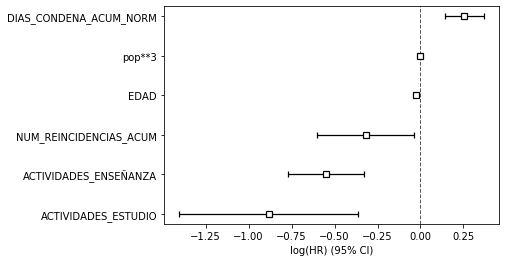

In [238]:
cph_cluster.print_summary()
cph_cluster.plot()

In [239]:
cph_cluster.check_assumptions(df_cph_clusters[cox_clusters], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'ACTIVIDADES_ESTUDIO' failed the non-proportional test: p-value is 0.0236.

   Advice: with so few unique values (only 2), you can include `strata=['ACTIVIDADES_ESTUDIO', ...]`
in the call in `.fit`. See documentation in link [E] below.

---
[A]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html
[B]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html#Bin-variable-and-stratify-on-it
[C]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html#Introduce-time-varying-covariates
[D]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html#Modify-the-functional-form
[E]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html#Stratification



## The results were totally surprising:
<br>
Only using the clusters to differentiate the baseline hazards and the GNIC, we obtained 0.7 c-value and all the covariates passed all the tests. This is definitely nice. Nevertheless, all the covariates coefficients vary in a very wide range and calculating the confidence intervals for the COX model is quite a complex task and we do not have the time to implement this routine ourselves.

<br>

Despite this, let's plot the survival curves and check the sizes of the groups... The results are awesome. The groups are widely populated and we are still getting such a nice c-value. This is worth exploring more.

In [753]:
cox_cluster_predict=["EDAD","tentativa","agravado","calificado","educacion", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
                  "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3","cluster"]      

tr_rows = df_cph_clusters.loc[df_cph_clusters.cluster == 6,cox_cluster_predict].iloc[0:10]
tr_rows

,EDAD,tentativa,agravado,calificado,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NUM_REINCIDENCIAS_ACUM,En_Carcel,DIAS_CONDENA_ACUM_NORM,gnic_strata,pop**3,cluster
5,32,0,0,0,2,0,0,1,0,2.612538,1,-13.553734,6
10,40,0,0,0,5,0,0,1,1,2.747222,0,-7.302113,6
32,36,0,0,1,5,1,0,1,0,3.466667,1,-0.318837,6
47,32,0,1,1,5,0,0,1,0,5.509760,1,27.271321,6
58,39,0,1,0,2,1,0,1,0,2.147222,0,-9.071642,6
60,39,0,0,1,5,0,0,1,0,2.751427,0,-9.071642,6
65,26,0,0,0,2,0,0,1,0,3.531983,0,-23.350140,6
74,47,0,0,1,2,1,0,1,0,2.380556,1,29.714074,6
88,22,0,0,1,5,0,0,1,1,1.013889,0,-10.542089,6
100,28,0,0,1,5,0,0,1,0,4.194444,0,-16.247268,6


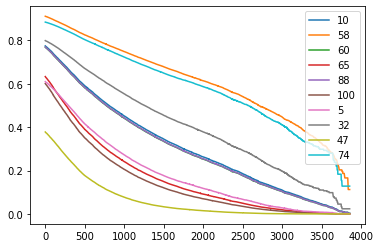

In [754]:
cph_cluster.predict_survival_function(tr_rows).plot()

### Awesome!

The survival curves do not cross, the are smooth due to the amount of samples in each group and using clusters allowed use to group samples nicely without losing the proportionality. These clusters, nevertheless, are highly based on sex and public health crimes which are not the most frequent. This is already good but we will keep on exploring.

# 7.2 Using the results of PCA-1 model. 

This model clustered the data giving a lot of importance to crime frequency, we proceed as before and check the results.

In [679]:
url="https://raw.githubusercontent.com/sagilar/ds4a-team6/master/INTERNO_clusters.csv"
clusters_2 = pd.read_csv(url, sep=",",encoding="utf-8")

In [680]:
clusters_2 = clusters_2.groupby("INTERNOEN").head(1)

In [755]:
df_cph_clusters2 = df_cph_acum.merge(clusters_2[["INTERNOEN","cluster_1"]], on = "INTERNOEN")

In [756]:
cox_clusters2=["EDAD", "NUMERO_REINCIDENCIAS",
          "DIAS_LIBRE","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito","pop",
                "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic","msch","shdi","cluster_1"]          
try:
    df_cph_clusters2["gnic"] = df_cph_clusters2["gnic"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_clusters2["msch"] = df_cph_clusters2["msch"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_clusters2["pop"] = df_cph_clusters2["pop"].apply(lambda x: np.float(x.replace(",",".")))
except:
    None
    
df_cph_clusters2 = df_cph_clusters2.loc[df_cph_clusters2["educacion"]<16,cox_clusters2]

df_cph_clusters2 = df_cph_clusters2.loc[df_cph_clusters2.NUM_REINCIDENCIAS_ACUM < 5,cox_clusters2]
df_cph_clusters2 = df_cph_clusters2.loc[df_cph_clusters2["DIAS_CONDENA_ACUM_NORM"]<9,cox_clusters2]

df_cph_clusters2["gnic_strata"] = df_cph_clusters2["gnic"].apply(lambda x: 1 if x > 13.3 else 0)
df_cph_clusters2['pop_strata'] = pd.cut(df_cph_clusters2['pop'], [0,1.5,3.5,9])
df_cph_clusters2['cond_strata'] = pd.cut(df_cph_clusters2['DIAS_CONDENA_ACUM_NORM'], [0,1.5,3.5,10])
df_cph_clusters2["pop**2"] = (df_cph_clusters2["pop"]-df_cph_clusters2["pop"].mean())**2
df_cph_clusters2["pop**3"] = (df_cph_clusters2["pop"]-df_cph_clusters2["pop"].mean())**3
df_cph_clusters2["cond**2"] = (df_cph_clusters2["DIAS_CONDENA_ACUM_NORM"]/df_cph_clusters2["DIAS_CONDENA_ACUM_NORM"].mean())**2
df_cph_clusters2["cond"] = (df_cph_clusters2["DIAS_CONDENA_ACUM_NORM"]-df_cph_clusters2["DIAS_CONDENA_ACUM_NORM"].mean())
df_cph_clusters2["edu_norm"] = df_cph_clusters2["educacion"]/df_cph_clusters2["msch"]

In [757]:
df_cph_clusters2

,EDAD,NUMERO_REINCIDENCIAS,DIAS_LIBRE,CENSURADO_LIBRES,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,tentativa,agravado,calificado,logDelito,pop,NUM_REINCIDENCIAS_ACUM,En_Carcel,DIAS_CONDENA_ACUM_NORM,gnic,msch,shdi,cluster_1,gnic_strata,pop_strata,cond_strata,pop**2,pop**3,cond**2,cond,edu_norm
0,37,1,0.000000,1,11,0,0,0,0,0,11.082596,0.982051,1,1,2.179205,14.809212,7.55,0.755,2,1,"(0.0, 1.5]","(1.5, 3.5]",5.758434,-13.818364,0.770444,-0.303515,1.456954
1,33,1,1727.511357,0,11,1,0,0,1,1,11.880779,0.781191,1,1,2.513889,6.839884,7.13,0.680,4,0,"(0.0, 1.5]","(1.5, 3.5]",6.762776,-17.586828,1.025267,0.031169,1.542777
2,40,1,1624.511357,0,5,1,0,0,0,0,11.082596,6.329860,1,1,1.341667,13.716267,8.04,0.755,1,1,"(3.5, 9.0]","(0.0, 1.5]",8.691501,25.623720,0.292034,-1.141053,0.621891
3,26,1,0.000000,1,9,0,0,0,1,1,11.880779,4.760812,1,1,1.968094,15.569108,9.04,0.785,2,1,"(3.5, 9.0]","(1.5, 3.5]",1.901881,2.622860,0.628400,-0.514626,0.995575
4,26,1,898.511357,0,11,1,0,0,0,0,11.082596,0.977043,1,1,0.586111,13.147209,8.51,0.770,4,0,"(0.0, 1.5]","(0.0, 1.5]",5.782495,-13.905060,0.055732,-1.896608,1.292597
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85441,66,2,1008.000000,1,5,1,0,0,0,0,11.082596,1.426243,1,1,2.144444,10.079057,6.56,0.712,1,0,"(0.0, 1.5]","(1.5, 3.5]",3.823909,-7.477585,0.746061,-0.338275,0.762195
85442,66,2,735.511357,0,5,1,0,0,0,0,11.082596,1.409977,2,1,4.461111,11.143699,7.21,0.739,1,0,"(0.0, 1.5]","(3.5, 10.0]",3.887789,-7.665740,3.228723,1.978392,0.693481
85443,53,1,0.000000,1,2,0,0,0,0,0,8.709308,0.976075,1,0,4.670871,14.576948,7.82,0.764,3,1,"(0.0, 1.5]","(3.5, 10.0]",5.787151,-13.921859,3.539489,2.188152,0.255754
85444,33,1,1424.511357,0,11,0,0,0,0,1,11.880779,7.887584,1,0,0.347222,16.668069,10.04,0.804,0,1,"(3.5, 9.0]","(0.0, 1.5]",20.302767,91.481409,0.019560,-2.135497,1.095618


In [300]:
cox_clusters2=["EDAD", "DIAS_LIBRE","CENSURADO_LIBRES", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"NUM_REINCIDENCIAS_ACUM", "DIAS_CONDENA_ACUM_NORM","gnic","pop**3","cluster_1"]      
cph_cluster2 = CoxPHFitter()

cph_cluster2.fit(df_cph_clusters2[cox_clusters2], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES',
              strata = ["ACTIVIDADES_ENSEÑANZA","ACTIVIDADES_ESTUDIO","NUM_REINCIDENCIAS_ACUM"],   cluster_col = "cluster_1",robust=True)

<lifelines.CoxPHFitter: fitted with 84142 total observations, 43828 right-censored observations>

model,lifelines.CoxPHFitter
duration col,'DIAS_LIBRE'
event col,'CENSURADO_LIBRES'
cluster col,'cluster_1'
robust variance,True
strata,"[ACTIVIDADES_ENSEÑANZA, ACTIVIDADES_ESTUDIO, N..."
baseline estimation,breslow
number of observations,84142
number of events observed,40314
partial log-likelihood,-374496.39
time fit was run,2020-08-01 14:32:27 UTC


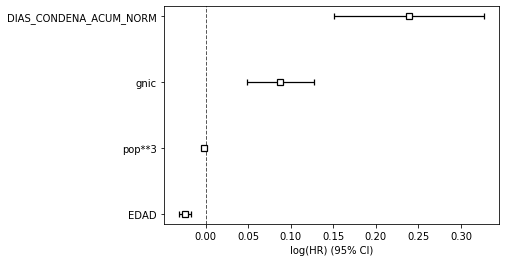

In [301]:
cph_cluster2.print_summary()
cph_cluster2.plot()

In [302]:
cph_cluster2.check_assumptions(df_cph_clusters2[cox_clusters2], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'DIAS_CONDENA_ACUM_NORM' failed the non-proportional test: p-value is 0.0068.

   Advice 1: the functional form of the variable 'DIAS_CONDENA_ACUM_NORM' might be incorrect. That
is, there may be non-linear terms missing. The proportional hazard test used is very sensitive to
incorrect functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'DIAS_CONDENA_ACUM_NORM' using pd.cut, and then specify it in
`strata=['DIAS_CONDENA_ACUM_NORM', ...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


2. Variable 'gnic' failed the non-proportional test: p-value is 0.0446.

   Advice 1: the functional form of the variable 'gnic' might be incorrect. That is, there may be
non-linear terms missing. The proportional hazard test used is very sensitive to incorrect
functional forms. See documentation 

## It's interesting ...
that we stratified a bit more using study and teach inside jails as stratums. We lost a bit the c-value down to 0.65 but we still perform well in the tests. Moreover, the covariates are not so variable (except for accumulated sentence length). The only drawback with this model is that the clusters are tremendously similar and given the purpose of our model, this does not seem as very useful to target programs and understand really why that happens.

# 7.3 Final model: PCA-2 clustering -> Prioritizing Education - Crime frequency - Gender
Using the PCA-2 model, we had very interesting group descriptions difering by gender, level of education, where the sentence was paid and the types of crimes. We know that we won't get a much higher c-value with the variables we are using. we also know that we are using the most reliable ones because of the discussions with the customer. Let's see what we get using these results.


In [681]:
df_cph_clusters3 = df_cph_acum.merge(clusters_2[["INTERNOEN","cluster_2"]], on = "INTERNOEN")

In [682]:
cox_clusters3=["EDAD", "NUMERO_REINCIDENCIAS",
          "DIAS_LIBRE","CENSURADO_LIBRES","educacion", "ACTIVIDADES_ESTUDIO",
        "ACTIVIDADES_ENSEÑANZA", "tentativa","agravado","calificado","logDelito","pop",
                "NUM_REINCIDENCIAS_ACUM", "En_Carcel","DIAS_CONDENA_ACUM_NORM","gnic","msch","shdi","cluster_2"]          
try:
    df_cph_clusters3["gnic"] = df_cph_clusters3["gnic"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_clusters3["msch"] = df_cph_clusters3["msch"].apply(lambda x: np.float(x.replace(",",".")))
    df_cph_clusters3["pop"] = df_cph_clusters3["pop"].apply(lambda x: np.float(x.replace(",",".")))
except:
    None
    
df_cph_clusters3 = df_cph_clusters3.loc[df_cph_clusters3["educacion"]<16,cox_clusters3]

df_cph_clusters3 = df_cph_clusters3.loc[df_cph_clusters3.NUM_REINCIDENCIAS_ACUM < 5,cox_clusters3]
df_cph_clusters3 = df_cph_clusters3.loc[df_cph_clusters3["DIAS_CONDENA_ACUM_NORM"]<9,cox_clusters3]

df_cph_clusters3["gnic_strata"] = df_cph_clusters3["gnic"].apply(lambda x: 1 if x > 13.3 else 0)
df_cph_clusters3['pop_strata'] = pd.cut(df_cph_clusters3['pop'], [0,1.5,3.5,9])
df_cph_clusters3['cond_strata'] = pd.cut(df_cph_clusters3['DIAS_CONDENA_ACUM_NORM'], [0,1.5,3.5,10])
df_cph_clusters3["pop**2"] = (df_cph_clusters3["pop"]-df_cph_clusters3["pop"].mean())**2
df_cph_clusters3["pop**3"] = (df_cph_clusters3["pop"]-df_cph_clusters3["pop"].mean())**3
df_cph_clusters3["cond**2"] = (df_cph_clusters3["DIAS_CONDENA_ACUM_NORM"]/df_cph_clusters3["DIAS_CONDENA_ACUM_NORM"].mean())**2
df_cph_clusters3["cond"] = (df_cph_clusters3["DIAS_CONDENA_ACUM_NORM"]-df_cph_clusters3["DIAS_CONDENA_ACUM_NORM"].mean())
df_cph_clusters3["edu_norm"] = df_cph_clusters3["educacion"]/df_cph_clusters3["msch"]

In [683]:
cox_clusters3=["EDAD","educacion", "DIAS_LIBRE","CENSURADO_LIBRES", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"NUM_REINCIDENCIAS_ACUM", "DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3","En_Carcel","cluster_2"]      
cph_cluster3 = CoxPHFitter()

cph_cluster3.fit(df_cph_clusters3[cox_clusters3], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES',
              strata=["NUM_REINCIDENCIAS_ACUM","gnic_strata","En_Carcel","ACTIVIDADES_ESTUDIO","ACTIVIDADES_ENSEÑANZA"],   cluster_col = "cluster_2",robust=True)

<lifelines.CoxPHFitter: fitted with 84142 total observations, 43828 right-censored observations>

model,lifelines.CoxPHFitter
duration col,'DIAS_LIBRE'
event col,'CENSURADO_LIBRES'
cluster col,'cluster_2'
robust variance,True
strata,"[NUM_REINCIDENCIAS_ACUM, gnic_strata, En_Carce..."
baseline estimation,breslow
number of observations,84142
number of events observed,40314
partial log-likelihood,-321514.84
time fit was run,2020-08-02 12:47:06 UTC


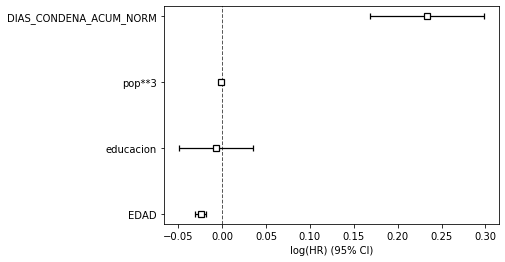

In [684]:
cph_cluster3.print_summary()
cph_cluster3.plot()

In [685]:
cph_cluster3.check_assumptions(df_cph_clusters3[cox_clusters3], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'DIAS_CONDENA_ACUM_NORM' failed the non-proportional test: p-value is 0.0255.

   Advice 1: the functional form of the variable 'DIAS_CONDENA_ACUM_NORM' might be incorrect. That
is, there may be non-linear terms missing. The proportional hazard test used is very sensitive to
incorrect functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'DIAS_CONDENA_ACUM_NORM' using pd.cut, and then specify it in
`strata=['DIAS_CONDENA_ACUM_NORM', ...]` in the call in `.fit`. See documentation in link [B] below.

   Advice 3: try adding an interaction term with your time variable. See documentation in link [C]
below.


---
[A]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html
[B]  https://lifelines.readthedocs.io/en/latest/jupyter_notebooks/Proportional%20hazard%20assumption.html#Bin-variable-and-stratify-on-it
[C]  https://lifelines.readthedocs.io/en/latest/ju

## Satisfying results:

With this model, we clearly have very interesting clusters. The cox proportionality is almost perfectly satisfied.
From previous models, we saw that education did not have a big impact in recidivism when compared to other variables. It's lack of statistical significance is not very surprising.

The length of the sentence still has a wide range of values but this seems affordable when we check how populated the groups are.

The effects of covariates are similar in each cluster model and agree with those obtained in **Model 6** with the additional advantage of having much more samples for each baseline hazard and therefore, we know that we achieve a very similar concordance while having much bigger groups of samples. Therefore, this model seems like the most reasonable choice.

### Important:

The other models are still interesting to explore, specially those with different clusters or very high c-values to explore prediction capabilities. This should be, nevertheless, be done in the context of proposals that can be formulated with the current survival model and the clustering model.

The c-value is in a good value considering that +80k samples are being fitted.

The prediction capabilities are very similar to **Model 6**.

In [758]:
cox_cluster_predict=["EDAD","educacion", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"NUM_REINCIDENCIAS_ACUM", "DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3","En_Carcel","cluster_2"]      

tr_rows = df_cph_clusters3.loc[df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == 2,cox_cluster_predict].iloc[0:10]
tr_rows
tr_rows = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == 2) & (df_cph_clusters3.ACTIVIDADES_ESTUDIO == 1) &
                               (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == 0) & (df_cph_clusters3.EDAD == 34) &
                               (df_cph_clusters3.En_Carcel == 1) & (df_cph_clusters3.gnic_strata == 1)
                               ,cox_cluster_predict].iloc[0:10,:]
tr_rows


,EDAD,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NUM_REINCIDENCIAS_ACUM,DIAS_CONDENA_ACUM_NORM,gnic_strata,pop**3,En_Carcel,cluster_2
455,34,11,1,0,2,2.952778,1,91.481409,1,1
623,34,2,1,0,2,2.666667,1,82.615315,1,4
1478,34,11,1,0,2,4.751427,1,35.291948,1,7
1524,34,2,1,0,2,2.455556,1,-1.977941,1,3
2833,34,5,1,0,2,5.325000,1,-2.292365,1,2
3842,34,2,1,0,2,3.675000,1,26.854413,1,9
4541,34,2,1,0,2,2.902778,1,98.953216,1,2
4752,34,5,1,0,2,7.705556,1,-13.836598,1,3
4925,34,5,1,0,2,3.508333,1,-14.736413,1,4
5260,34,9,1,0,2,0.702778,1,-22.323596,1,5


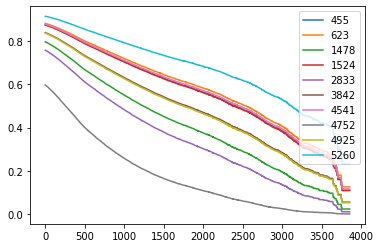

In [759]:
cph_cluster.predict_survival_function(tr_rows).plot()

In [688]:
_predict = cph_cluster.predict_expectation(df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM==2) &
      (df_cph_clusters3.CENSURADO_LIBRES==0) &  (df_cph_clusters3.DIAS_LIBRE<1500)
                     &  (df_cph_clusters3.DIAS_LIBRE>0),cox_cluster_predict].iloc[0:1000])#,conditional_after=np.ones(16829)*3000)


In [689]:
df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM==2) &
      (df_cph_clusters3.CENSURADO_LIBRES==0) &  (df_cph_clusters3.DIAS_LIBRE<1500)
                     &  (df_cph_clusters3.DIAS_LIBRE>0),cox_clusters3].iloc[0:1000]

,EDAD,educacion,DIAS_LIBRE,CENSURADO_LIBRES,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NUM_REINCIDENCIAS_ACUM,DIAS_CONDENA_ACUM_NORM,gnic_strata,pop**3,En_Carcel,cluster_2
21,92,2,1115.511357,0,1,0,2,2.769444,1,32.151977,0,9
45,30,5,448.511357,0,1,0,2,4.672222,1,1.622368,1,0
49,25,11,873.511357,0,1,0,2,2.452778,1,2.234723,1,8
68,34,5,281.511357,0,1,0,2,5.191667,1,-2.133197,0,5
88,37,11,776.511357,0,1,0,2,2.125000,1,98.953216,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...
9835,41,13,823.511357,0,1,0,2,3.972222,1,91.481409,0,5
9842,71,2,493.511357,0,1,0,2,5.300000,1,32.151977,0,5
9845,38,5,1170.511357,0,1,0,2,1.869444,1,1.894795,1,3
9854,32,11,683.511357,0,1,0,2,5.861111,1,-22.323596,1,5


In [690]:
_predict.describe()
_predict

21      3307.621797
45      1360.760916
49      1871.323294
68      1320.798791
88      2451.672338
           ...     
9835    2045.676434
9842    2420.442652
9845    2402.598420
9854    1043.832730
9879    1772.771105
Length: 1000, dtype: float64

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002367D006550>]],
      dtype=object)

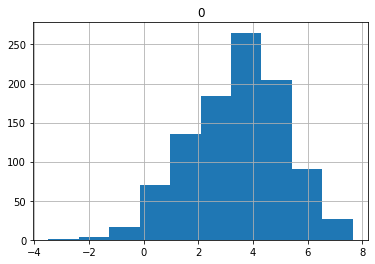

In [691]:
dif = pd.DataFrame((_predict - df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM==2) &
      (df_cph_clusters3.CENSURADO_LIBRES==0) &  (df_cph_clusters3.DIAS_LIBRE<1500)
                     &  (df_cph_clusters3.DIAS_LIBRE>0),cox_clusters3].iloc[0:1000].DIAS_LIBRE)/(30*12))
dif[dif[0]!=np.inf].hist()

In [692]:
dif[dif[0]!=np.inf].describe()

,0
count,1000.000000
mean,3.411756
std,1.741879
min,-3.487596
25%,2.280245
50%,3.545680
75%,4.592436
max,7.655686


In [720]:
pk.dump(cph_cluster,open("modelo_cox_cluster.pickle","wb"))

In [760]:
#Alternative to pickle----------------------
# import joblib

# joblib.dump(cph_cluster, "modelo_cox_cluster.pickle")
# modelo = joblib.load("modelo_cox_cluster.pickle")

In [699]:
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 1
cluster = 9

target_group = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cph_clusters3.En_Carcel == jail) & \
                (df_cph_clusters3.gnic_strata == gnic) & (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cph_clusters3.ACTIVIDADES_ESTUDIO == study) & (df_cph_clusters3.cluster_2 == cluster), cox_cluster_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()

test = pd.DataFrame([[age_mean,educ_mean,study,teach,recidiv,condemn_mean,gnic,pop_mean,jail,cluster]])
test.columns = cox_cluster_predict

survival_df = cph_cluster.predict_survival_function(test).reset_index()
survival_df
#-----------------------------------
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0
cluster = 9

target_group = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cph_clusters3.En_Carcel == jail) & \
                (df_cph_clusters3.gnic_strata == gnic) & (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cph_clusters3.ACTIVIDADES_ESTUDIO == study) & (df_cph_clusters3.cluster_2 == cluster), cox_cluster_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()


test2 = pd.DataFrame([[age_mean,educ_mean,study,teach,recidiv,condemn_mean,gnic,pop_mean,jail,cluster]])
test2.columns = cox_cluster_predict

survival_df2 = cph_cluster.predict_survival_function(test2).reset_index()
survival_df2
#-----------------------------
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=survival_df["index"]/30, y=survival_df[0], name="<b>Study in Jail</b>",line_shape='vhv',
        line_color="red",
#         name=name,
    showlegend=True
    ))

fig.add_trace(go.Scatter(
        x=survival_df2["index"]/30, y=survival_df2[0], name="<b>Not study in Jail</b>",line_shape='vhv',
#         line_color=line_color_l,
#         name=name,
    line_color="blue",
    showlegend=True
    ))

fig.update_layout(
    xaxis_title ="<b>Months</b>",
    yaxis_title = "<b>P(t > T)</b>",
    title = '<b>Probability of not returning to jail</b>',
    font=dict(
        family="Courier New, monospace",
        size=22,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


In [725]:
jails = [0,1]
clusters = [2,7]
colors = ["gray","blue","green","purple"]
# jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0

fig = go.Figure()

for jail in jails:
    for cluster in clusters:
        target_group = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cph_clusters3.En_Carcel == jail) & \
                (df_cph_clusters3.gnic_strata == gnic) & (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cph_clusters3.ACTIVIDADES_ESTUDIO == study) & (df_cph_clusters3.cluster_2 == cluster), cox_cluster_predict]

        educ_mean = target_group.educacion.mean()
        age_mean = target_group.EDAD.mean()
        pop_mean = target_group["pop**3"].mean()
        condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()
        
        test = pd.DataFrame([[age_mean,educ_mean,study,teach,recidiv,condemn_mean,gnic,pop_mean,jail,cluster]])
        test.columns = cox_cluster_predict

        survival_df = cph_cluster.predict_survival_function(test).reset_index()
        survival_df
        
        if jail == 1:
            name = f"<b>In Jail, <br>Cluster {cluster}</b>"
            if cluster == clusters[0]:
                color = colors[0]
            else: color = colors[1]
        else:
            name = f"<b>House Arrest, <br>Cluster {cluster}</b>"
            if cluster == clusters[0]:
                color = colors[2]
            else: color = colors[3]
                
        fig.add_trace(go.Scatter(
                x=survival_df["index"]/30, y=survival_df[0], name=name,line_shape='vhv',
                line_color=color,
        #         name=name,
            showlegend=True
            ))            

fig.update_layout(
    xaxis_title ="<b>Months</b>",
    yaxis_title = "<b>P(t > T)</b>",
    title = '<b>Probability of not returning to jail</b>',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


In [703]:
jail = 1
gnic = 1
recidiv = 1
teach = 0
study = 0
cluster = 3

target_group = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cph_clusters3.En_Carcel == jail) & \
                (df_cph_clusters3.gnic_strata == gnic) & (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cph_clusters3.ACTIVIDADES_ESTUDIO == study) & (df_cph_clusters3.cluster_2 == cluster), cox_cluster_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()

test = pd.DataFrame([[age_mean,educ_mean,study,teach,recidiv,condemn_mean,gnic,pop_mean,jail,cluster]])
test.columns = cox_cluster_predict

survival_df = cph_cluster.predict_survival_function(test).reset_index()
survival_df
#-----------------------------------
jail = 1
gnic = 0
recidiv = 1
teach = 0
study = 0
cluster = 3

target_group = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cph_clusters3.En_Carcel == jail) & \
                (df_cph_clusters3.gnic_strata == gnic) & (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cph_clusters3.ACTIVIDADES_ESTUDIO == study) & (df_cph_clusters3.cluster_2 == cluster), cox_cluster_predict]

educ_mean = target_group.educacion.mean()
age_mean = target_group.EDAD.mean()
pop_mean = target_group["pop**3"].mean()
condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()


test2 = pd.DataFrame([[age_mean,educ_mean,study,teach,recidiv,condemn_mean,gnic,pop_mean,jail,cluster]])
test2.columns = cox_cluster_predict

survival_df2 = cph_cluster.predict_survival_function(test2).reset_index()
survival_df2
#-----------------------------
fig = go.Figure()

fig.add_trace(go.Scatter(
        x=survival_df["index"]/30, y=survival_df[0], name="<b>High gnic</b>",line_shape='vhv',
        line_color="red",
#         name=name,
    showlegend=True
    ))

fig.add_trace(go.Scatter(
        x=survival_df2["index"]/30, y=survival_df2[0], name="<b>Low gnic</b>",line_shape='vhv',
#         line_color=line_color_l,
#         name=name,
    line_color="blue",
    showlegend=True
    ))

fig.update_layout(
    xaxis_title ="<b>Months</b>",
    yaxis_title = "<b>P(t > T)</b>",
    title = '<b>Probability of not returning to jail</b>',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


In [705]:
recidivs = [1,2]
clusters = [2,9]
colors = ["gray","blue","green","purple"]

jail = 1
gnic = 0
# recidiv = 1
teach = 0
study = 0

fig = go.Figure()

for recidiv in recidivs:
    for cluster in clusters:
        target_group = df_cph_clusters3.loc[(df_cph_clusters3.NUM_REINCIDENCIAS_ACUM == recidiv) & (df_cph_clusters3.En_Carcel == jail) & \
                (df_cph_clusters3.gnic_strata == gnic) & (df_cph_clusters3.ACTIVIDADES_ENSEÑANZA == teach) & \
                (df_cph_clusters3.ACTIVIDADES_ESTUDIO == study) & (df_cph_clusters3.cluster_2 == cluster), cox_cluster_predict]

        educ_mean = target_group.educacion.mean()
        age_mean = target_group.EDAD.mean()
        pop_mean = target_group["pop**3"].mean()
        condemn_mean = target_group.DIAS_CONDENA_ACUM_NORM.mean()
        
        test = pd.DataFrame([[age_mean,educ_mean,study,teach,recidiv,condemn_mean,gnic,pop_mean,jail,cluster]])
        test.columns = cox_cluster_predict

        survival_df = cph_cluster.predict_survival_function(test).reset_index()
        survival_df
        
        if recidiv == recidivs[0]:
            name = f"<b>First recidivism, <br>Cluster {cluster}</b>"
            if cluster == clusters[0]:
                color = colors[0]
            else: color = colors[1]
        else:
            name = f"<b>Second recidivism, <br>Cluster {cluster}</b>"
            if cluster == clusters[0]:
                color = colors[2]
            else: color = colors[3]
                
        fig.add_trace(go.Scatter(
                x=survival_df["index"]/30, y=survival_df[0], name=name,line_shape='vhv',
                line_color=color,
        #         name=name,
            showlegend=True
            ))            

fig.update_layout(
    xaxis_title ="<b>Months</b>",
    yaxis_title = "<b>P(t > T)</b>",
    title = '<b>Probability of not returning to jail</b>',
    font=dict(
        family="Courier New, monospace",
        size=18,
        color="#7f7f7f"
    )
)

fig.update_traces(hoverinfo='all', mode='lines')
fig.update_layout(legend=dict(y=0.5, traceorder='reversed', font_size=16))

fig.show()


# Train-test splitting and final checks

Using the last model, we splitted the dataset in train/test (0.8/0.2) to check if the capabilities of the model remained. For this, we stratified the split in order to avoid under represented groups. 
<br>
The results were very similar to the original model using the whole dataset. This was true for prediction and for model behavior (c-value, rank - KM tests, statistical significance of covariates and behavior of survival curves)

In this section, we also tried prediction with a model with higher c-value, obtaining very similar results to the other models, further confirming our thoughts.

After literature review and trying several models, we can notice some differences worth highlighting:

### More accurate models use more personal information such as:

#### - Drug-addiction records
#### - First crime records
#### - Information such as fines or details of the committed crimes
#### - Race

### Information worth gathering to improve the model

#### - Socioeconomic status of the person
#### - Race
#### - First crime information
#### - Details of reclusion center and improve data gathering on this
#### - Improve data quality on where the sentence is paid (all in jail, all in house arrest, partial, etc...)

In [418]:
from sklearn.model_selection import train_test_split

train_cols=["EDAD","educacion", "DIAS_LIBRE","CENSURADO_LIBRES","ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"NUM_REINCIDENCIAS_ACUM", "DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3","En_Carcel","cluster_2"]  

x_train, x_test = train_test_split(df_cph_clusters3[train_cols], 
    test_size=0.2, random_state=42, stratify = df_cph_clusters3[["NUM_REINCIDENCIAS_ACUM","gnic_strata",
    "cluster_2"]])

In [419]:
x_train

,EDAD,educacion,DIAS_LIBRE,CENSURADO_LIBRES,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,NUM_REINCIDENCIAS_ACUM,DIAS_CONDENA_ACUM_NORM,gnic_strata,pop**3,En_Carcel,cluster_2
40386,38,5,1964.511357,0,1,0,1,2.877778,0,-28.562057,1,5
73226,35,9,3564.511357,0,1,0,1,0.480556,0,0.633415,1,3
10559,41,11,841.511357,0,1,0,2,2.158333,0,-9.055878,1,1
66931,29,11,0.000000,1,0,0,1,3.818094,1,91.481409,1,3
59803,30,2,0.000000,1,0,0,1,7.959760,0,-2.725273,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...
24964,38,2,392.511357,0,1,0,1,0.961111,1,-21.913281,1,5
31682,42,5,999.000000,1,0,0,1,1.622222,0,-8.429304,1,8
41569,29,11,909.511357,0,1,0,1,1.888889,0,-2.106671,1,9
38279,62,5,87.000000,1,1,0,1,0.352778,1,1.120441,1,0


In [420]:
cox_clusters3=["EDAD","educacion", "DIAS_LIBRE","CENSURADO_LIBRES", "ACTIVIDADES_ESTUDIO", "ACTIVIDADES_ENSEÑANZA", 
"NUM_REINCIDENCIAS_ACUM", "DIAS_CONDENA_ACUM_NORM","gnic_strata","pop**3","En_Carcel","cluster_2"]      

cph_train = CoxPHFitter()

cph_train.fit(x_train[cox_clusters3], 'DIAS_LIBRE', event_col = 'CENSURADO_LIBRES',
              strata=["NUM_REINCIDENCIAS_ACUM","gnic_strata"],   cluster_col = "cluster_2",robust=True)

<lifelines.CoxPHFitter: fitted with 67313 total observations, 35008 right-censored observations>

model,lifelines.CoxPHFitter
duration col,'DIAS_LIBRE'
event col,'CENSURADO_LIBRES'
cluster col,'cluster_2'
robust variance,True
strata,"[NUM_REINCIDENCIAS_ACUM, gnic_strata]"
baseline estimation,breslow
number of observations,67313
number of events observed,32305
partial log-likelihood,-293766.68
time fit was run,2020-08-01 17:00:37 UTC


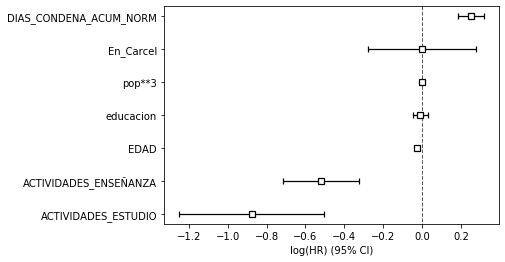

In [421]:
cph_train.print_summary()
cph_train.plot()

In [422]:
cph_train.check_assumptions(x_train[cox_clusters3], p_value_threshold=0.05, show_plots=False)

The ``p_value_threshold`` is set at 0.05. Even under the null hypothesis of no violations, some
covariates will be below the threshold by chance. This is compounded when there are many covariates.
Similarly, when there are lots of observations, even minor deviances from the proportional hazard
assumption will be flagged.

With that in mind, it's best to use a combination of statistical tests and visual tests to determine
the most serious violations. Produce visual plots using ``check_assumptions(..., show_plots=True)``
and looking for non-constant lines. See link [A] below for a full example.





1. Variable 'ACTIVIDADES_ESTUDIO' failed the non-proportional test: p-value is 0.0011.

   Advice: with so few unique values (only 2), you can include `strata=['ACTIVIDADES_ESTUDIO', ...]`
in the call in `.fit`. See documentation in link [E] below.

2. Variable 'ACTIVIDADES_ENSEÑANZA' failed the non-proportional test: p-value is 0.0211.

   Advice: with so few unique values (only 2), you can include `strata=['ACTIVIDADES_ENSEÑANZA',
...]` in the call in `.fit`. See documentation in link [E] below.

3. Variable 'DIAS_CONDENA_ACUM_NORM' failed the non-proportional test: p-value is 0.0278.

   Advice 1: the functional form of the variable 'DIAS_CONDENA_ACUM_NORM' might be incorrect. That
is, there may be non-linear terms missing. The proportional hazard test used is very sensitive to
incorrect functional forms. See documentation in link [D] below on how to specify a functional form.

   Advice 2: try binning the variable 'DIAS_CONDENA_ACUM_NORM' using pd.cut, and then specify it in
`str

In [457]:
x_predict = cph_train.predict_median(x_test)#,conditional_after=np.ones(16829)*3000)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002367A61B220>]],
      dtype=object)

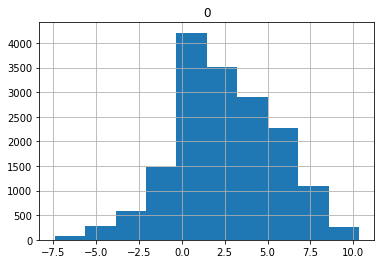

In [477]:
dif = pd.DataFrame((x_predict - x_test.DIAS_LIBRE)/(30*12))
dif[dif[0]!=np.inf].hist()

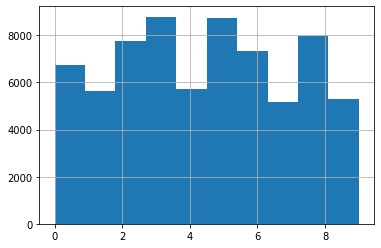

In [662]:
df_cph_clusters3[df_cph_clusters3.DIAS_LIBRE <2000].cluster_2.hist()

In [719]:
df_cph_clusters3[(df_cph_clusters3["NUM_REINCIDENCIAS_ACUM"]==2)].shape[0]/ (
    df_cph_clusters3[(df_cph_clusters3["NUM_REINCIDENCIAS_ACUM"]==1) & (df_cph_clusters3["CENSURADO_LIBRES"]==0)].shape[0])


0.5232128053057841

In [667]:
df_cph_clusters3

,EDAD,NUMERO_REINCIDENCIAS,DIAS_LIBRE,CENSURADO_LIBRES,educacion,ACTIVIDADES_ESTUDIO,ACTIVIDADES_ENSEÑANZA,tentativa,agravado,calificado,logDelito,pop,NUM_REINCIDENCIAS_ACUM,En_Carcel,DIAS_CONDENA_ACUM_NORM,gnic,msch,shdi,cluster_2,gnic_strata,pop_strata,cond_strata,pop**2,pop**3,cond**2,cond,edu_norm
0,37,1,0.000000,1,11,0,0,0,0,0,11.082596,0.982051,1,1,2.179205,14.809212,7.55,0.755,3,1,"(0.0, 1.5]","(1.5, 3.5]",5.758434,-13.818364,0.770444,-0.303515,1.456954
1,33,1,1727.511357,0,11,1,0,0,1,1,11.880779,0.781191,1,1,2.513889,6.839884,7.13,0.680,1,0,"(0.0, 1.5]","(1.5, 3.5]",6.762776,-17.586828,1.025267,0.031169,1.542777
2,40,1,1624.511357,0,5,1,0,0,0,0,11.082596,6.329860,1,1,1.341667,13.716267,8.04,0.755,5,1,"(3.5, 9.0]","(0.0, 1.5]",8.691501,25.623720,0.292034,-1.141053,0.621891
3,26,1,0.000000,1,9,0,0,0,1,1,11.880779,4.760812,1,1,1.968094,15.569108,9.04,0.785,3,1,"(3.5, 9.0]","(1.5, 3.5]",1.901881,2.622860,0.628400,-0.514626,0.995575
4,26,1,898.511357,0,11,1,0,0,0,0,11.082596,0.977043,1,1,0.586111,13.147209,8.51,0.770,1,0,"(0.0, 1.5]","(0.0, 1.5]",5.782495,-13.905060,0.055732,-1.896608,1.292597
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
85441,66,2,1008.000000,1,5,1,0,0,0,0,11.082596,1.426243,1,1,2.144444,10.079057,6.56,0.712,5,0,"(0.0, 1.5]","(1.5, 3.5]",3.823909,-7.477585,0.746061,-0.338275,0.762195
85442,66,2,735.511357,0,5,1,0,0,0,0,11.082596,1.409977,2,1,4.461111,11.143699,7.21,0.739,5,0,"(0.0, 1.5]","(3.5, 10.0]",3.887789,-7.665740,3.228723,1.978392,0.693481
85443,53,1,0.000000,1,2,0,0,0,0,0,8.709308,0.976075,1,0,4.670871,14.576948,7.82,0.764,8,1,"(0.0, 1.5]","(3.5, 10.0]",5.787151,-13.921859,3.539489,2.188152,0.255754
85444,33,1,1424.511357,0,11,0,0,0,0,1,11.880779,7.887584,1,0,0.347222,16.668069,10.04,0.804,7,1,"(3.5, 9.0]","(0.0, 1.5]",20.302767,91.481409,0.019560,-2.135497,1.095618
